Connected to .venv (Python 3.10.14)

In [ ]:
# import all necessary libraries
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import numpy as np
import scipy.io
from PIL import Image
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torchvision.models as models
from torch.nn.functional import mse_loss
from pytorch_msssim import ssim
import os
import cv2

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

# Define the paths to your dataset and mask folders
dataset_folder = "/home/viswam1@ds.vanderbilt.edu/Project_DS5660/dataset"  # Folder containing your dataset images (e.g., PNG files)

# Load the masks from the .mat file
mat = scipy.io.loadmat('datasets.mat')
masks = mat['masks']

# List all files in the dataset folder and ensure the files in dataset and mask match
dataset_files = sorted(os.listdir(dataset_folder))  # Sorting to match dataset to masks


# Initialize empty numpy arrays to store images and masks
rgbs = np.zeros((40, 475, 475, 4), dtype=np.uint8)  # For RGBA images
masks_new = np.zeros((40, 475, 475), dtype=np.uint8)  # For mask images

# Process each sample and its corresponding mask
for i, dataset_file in enumerate(dataset_files):
    # Construct full file paths
    dataset_image_path = os.path.join(dataset_folder, dataset_file)

    # Open the dataset image (assumed to be a PNG)
    dataset_image = Image.open(dataset_image_path).convert("RGBA")

    # Resize the image to 475x475
    dataset_image_resized = dataset_image.resize((475, 475))

    # Create a white background image (RGBA) with the same size as the resized image
    white_background = Image.new("RGBA", dataset_image_resized.size, (255, 255, 255, 255))
    
    # Paste the dataset image onto the white background
    white_background.paste(dataset_image_resized, (0, 0), dataset_image_resized)

    # Convert the image to a NumPy array and store it in the rgb_images_array
    rgbs[i] = np.array(white_background)

    # Get the corresponding mask (assuming masks are stored in the third dimension of the array)
    mask_array = masks[i, :, :]  # Get the i-th mask for the i-th image

    # Resize the mask to 475x475 to match the resized image
    mask_resized = Image.fromarray(mask_array).resize((475, 475), Image.NEAREST)
    mask_array_resized = np.array(mask_resized)

    # Store the resized mask in the masks_array
    masks_new[i] = mask_array_resized

# Check the shapes of the resulting arrays
print(f"Shape of RGB images array: {rgbs.shape}")
print(f"Shape of masks array: {masks_new.shape}")

Shape of RGB images array: (40, 475, 475, 4)
Shape of masks array: (40, 475, 475)


In [ ]:
augmentation_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(30),  # Random rotations
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.RandomAffine(degrees=30, translate=(0.1, 0.1), scale=(0.8, 1.2)),  # Add degrees argument
    transforms.RandomResizedCrop(475, scale=(0.8, 1.0)),  # Crop and resize
])

# Create Dataset Class
class SegmentationDataset(Dataset):
    def __init__(self, masks, rgbs, transform_masks=None, transform_rgbs=None):
        self.masks = masks
        self.rgbs = rgbs
        self.transform_masks = transform_masks
        self.transform_rgbs = transform_rgbs

    def __len__(self):
        return len(self.masks)

    def __getitem__(self, idx):
        mask = Image.fromarray(self.masks[idx])
        rgb = Image.fromarray(self.rgbs[idx])
        if self.transform_masks:
            mask = self.transform_masks(mask)
        if self.transform_rgbs:
            rgb = self.transform_rgbs(rgb)

        return mask, rgb

Shape of masks array: (40, 475, 475, 3)
Shape of masks batch: torch.Size([4, 3, 475, 475])
Shape of RGBs batch: torch.Size([4, 3, 475, 475])


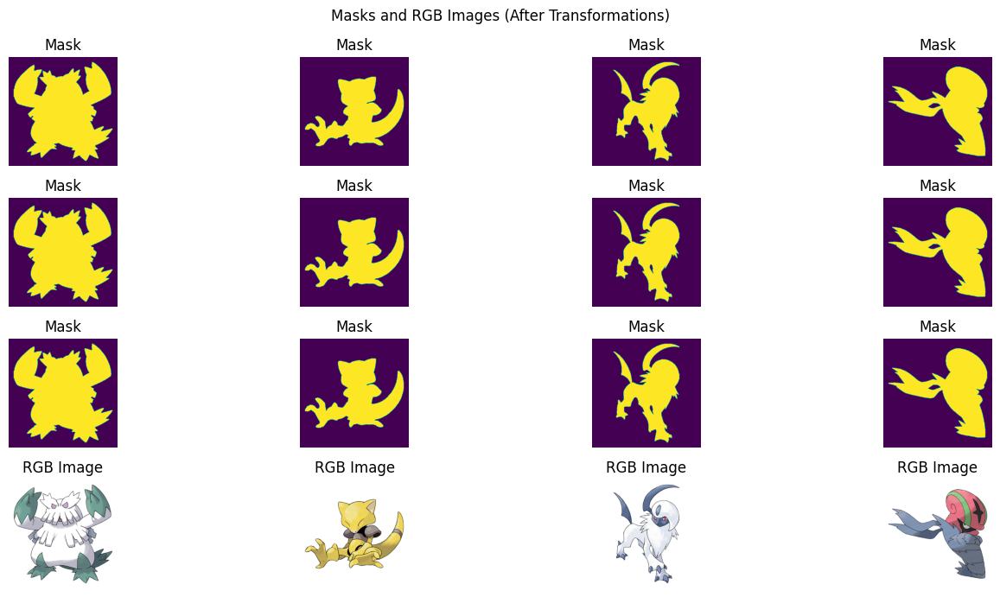

In [ ]:
transform_masks = transforms.Compose([
    transforms.Resize((475, 475)),
    transforms.ToTensor() # Convert 1-channel mask to 3-channel mask
])

# RGB transformation
transform_rgbs = transforms.Compose([
    transforms.Resize((475, 475)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.25, 0.25, 0.25])
])

# Resize and tile the masks to 3 channels for compatibility
masks_new = masks_new[:,:,:,np.newaxis]  # Add channel dimension
masks_resized = np.tile(masks_new, (1, 1, 1, 3))  # Repeat across 3 channels
rgbs = rgbs[:,:,:,0:3]
print(f"Shape of masks array: {masks_resized.shape}")


dataset = SegmentationDataset(masks_resized, rgbs, transform_masks, transform_rgbs)
dataloader = DataLoader(dataset, batch_size=4, shuffle=False)

# Visualization function
def plot_masks_and_rgbs_with_transforms(masks_batch, rgbs_batch):
    """
    Plot masks and RGB images side by side after applying transformations.
    Args:
        masks_batch: Batch of mask tensors (processed by transform_masks pipeline).
        rgbs_batch: Batch of RGB tensors (processed by transform_rgbs pipeline).
    """
    # Ensure masks are in the expected shape [batch_size, 3, H, W]
    masks_new = masks_batch.permute(0, 2, 3, 1).cpu().numpy()  # Convert to [batch_size, H, W, 3] for plotting
    masks_1 = masks_new[:, :, :, 0].squeeze()
    masks_2 = masks_new[:, :, :, 1].squeeze()
    masks_3 = masks_new[:, :, :, 2].squeeze()

    # Ensure RGB values are in a usable range for plotting
    rgbs = rgbs_batch.permute(0, 2, 3, 1).cpu().numpy()  # Convert to [batch_size, H, W, 3] for plotting

    # Unnormalize RGBs: reverse the normalization
    rgbs = rgbs * [0.25, 0.25, 0.25] + [0.5, 0.5, 0.5]  # Reverse normalization
    rgbs = (rgbs * 255).clip(0, 255).astype("uint8")  # Scale to 0-255 for plotting

    batch_size = masks_batch.shape[0]

    plt.figure(figsize=(15, 7))

    for i in range(batch_size):
        # Plot mask (now [H, W, 3], so it can be displayed as RGB)
        plt.subplot(4, batch_size, i + 1)
        plt.imshow(masks_1[i])  # Display the RGB mask
        plt.axis("off")
        plt.title("Mask")

        plt.subplot(4, batch_size, i + 1 + batch_size)
        plt.imshow(masks_2[i])  # Display the RGB mask
        plt.axis("off")
        plt.title("Mask")

        plt.subplot(4, batch_size, i + 1 + batch_size + batch_size)
        plt.imshow(masks_3[i])  # Display the RGB mask
        plt.axis("off")
        plt.title("Mask")

        # Plot RGB (actual RGB image)
        plt.subplot(4, batch_size, i + 1 + batch_size + batch_size + batch_size)
        plt.imshow(rgbs[i])  # Display the RGB image
        plt.axis("off")
        plt.title("RGB Image")

    plt.suptitle("Masks and RGB Images (After Transformations)")
    plt.tight_layout()
    plt.show()

# Example to test the DataLoader and visualization
for masks, rgbs in dataloader:
    # Plot masks and RGBs together
    print(f"Shape of masks batch: {masks.shape}")
    print(f"Shape of RGBs batch: {rgbs.shape}")
    
    plot_masks_and_rgbs_with_transforms(masks, rgbs)
    break  # Stop after the first batch

In [ ]:
class SEBlock(nn.Module):
    def __init__(self, channel, reduction=16):
        super(SEBlock, self).__init__()
        self.fc1 = nn.Conv2d(channel, channel // reduction, kernel_size=1)
        self.relu = nn.ReLU(inplace=True)
        self.fc2 = nn.Conv2d(channel // reduction, channel, kernel_size=1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Squeeze
        avg_pool = F.adaptive_avg_pool2d(x, 1)
        x = self.fc1(avg_pool)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.sigmoid(x)
        # Excitation
        return x * x  # Multiply by input for attention

class UNetGenerator(nn.Module):
    def __init__(self, input_channels=3, output_channels=3):
        super(UNetGenerator, self).__init__()

        # Encoder (Downsampling) with batch normalization and LeakyReLU
        self.encoder1 = self.conv_block(input_channels, 64)
        self.encoder2 = self.conv_block(64, 128)
        self.encoder3 = self.conv_block(128, 256)
        self.encoder4 = self.conv_block(256, 512)

        # Bottleneck with dropout for regularization
        self.bottleneck = self.conv_block(512, 1024, use_dropout=True)

        # Attention layers after each decoding stage
        self.attn4 = SEBlock(512)
        self.attn3 = SEBlock(256)
        self.attn2 = SEBlock(128)
        self.attn1 = SEBlock(64)

        # Decoder (Upsampling) with skip connections
        self.decoder4 = self.conv_block(1024 + 512, 512)
        self.decoder3 = self.conv_block(512 + 256, 256)
        self.decoder2 = self.conv_block(256 + 128, 128)
        self.decoder1 = self.conv_block(128 + 64, 64)

        # Output layer (output RGB image)
        self.output = nn.Conv2d(64, output_channels, kernel_size=1, stride=1, padding=0)

    def conv_block(self, in_channels, out_channels, use_dropout=False):
        """Helper function to create a convolutional block with Conv2d, BatchNorm, LeakyReLU, and optionally Dropout"""
        layers = [
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2, inplace=True),  # LeakyReLU for better gradient flow
            nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2, inplace=True)
        ]
        if use_dropout:
            layers.append(nn.Dropout(0.5))  # Dropout to prevent overfitting in bottleneck

        return nn.Sequential(*layers)

    def forward(self, x):
        # Encoder (Downsampling)
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(F.max_pool2d(enc1, 2))
        enc3 = self.encoder3(F.max_pool2d(enc2, 2))
        enc4 = self.encoder4(F.max_pool2d(enc3, 2))

        # Bottleneck
        bottleneck = self.bottleneck(F.max_pool2d(enc4, 2))
        bottleneck_up = F.interpolate(bottleneck, size=enc4.size()[2:], mode='bilinear', align_corners=True)
        dec4 = self.decoder4(torch.cat([bottleneck_up, enc4], 1))
        
        # Apply attention after each decoder
        dec4 = self.attn4(dec4) * dec4
        dec3 = self.decoder3(torch.cat([F.interpolate(dec4, scale_factor=2, mode='bilinear', align_corners=True), enc3], 1))
        dec3 = self.attn3(dec3) * dec3
        dec2 = self.decoder2(torch.cat([F.interpolate(dec3, size=enc2.size()[2:], mode='bilinear', align_corners=True), enc2], 1))
        dec2 = self.attn2(dec2) * dec2
        dec1 = self.decoder1(torch.cat([F.interpolate(dec2, size=enc1.size()[2:], mode='bilinear', align_corners=True), enc1], 1))
        dec1 = self.attn1(dec1) * dec1

        # Output layer
        out = self.output(dec1)

        return torch.tanh(out)
# PatchGAN Discriminator Network (as described in the paper)
class PatchGANDiscriminator(nn.Module):
    def __init__(self):
        super(PatchGANDiscriminator, self).__init__()

        self.model = nn.Sequential(
            nn.Conv2d(6, 64, kernel_size=4, stride=2, padding=1),  # 6 channels: RGB + Mask
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)  # Output a single value per patch
        )

    def forward(self, img, mask):
        # Ensure that the img and mask have the same spatial dimensions
        mask = self.match_dimensions(mask, img)  # Resize the mask to match the image dimensions
        # Concatenate the img and mask along the channel dimension (dim=1)
        x = torch.cat((img, mask), 1)  # Concatenate along the channel dimension
        return self.model(x)  # Pass through the model (or network layers)

    def match_dimensions(self, tensor1, tensor2):
        """Resize tensor1 to match the spatial dimensions of tensor2."""
        if tensor1.size(2) != tensor2.size(2) or tensor1.size(3) != tensor2.size(3):
            tensor1 = F.interpolate(tensor1, size=(tensor2.size(2), tensor2.size(3)), mode='bilinear', align_corners=True)
        return tensor1

In [ ]:
# Initialize Models
generator = UNetGenerator(input_channels=3, output_channels=3).to(device)
discriminator = PatchGANDiscriminator().to(device)
# Optimizers
optimizer_g = optim.Adam(generator.parameters(), lr=0.0001, betas=(0.9, 0.999))
optimizer_d = optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.9, 0.999))

# Loss function
criterion_d = nn.BCEWithLogitsLoss()
criterion_g = nn.BCEWithLogitsLoss()
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        nn.init.xavier_uniform_(m.weight.data)
        if m.bias is not None:
            nn.init.constant_(m.bias.data, 0)


generator.apply(weights_init)     

def plot_images(epoch, real_image, fake_image, title="Epoch",save_dir="training_results"):
    """Helper function to plot real and fake images side by side"""
    # Convert tensor to numpy array for both real and fake images

    os.makedirs(save_dir, exist_ok=True)
    mean = torch.tensor([0.5, 0.5, 0.5], device=real_image.device).view(1, 3, 1, 1)
    std = torch.tensor([0.25, 0.25, 0.25], device=real_image.device).view(1, 3, 1, 1)

    # Reverse normalization
    real_image = real_image * std + mean
    fake_image = fake_image * std + mean

    real_image = real_image.squeeze(0).detach().cpu().numpy()  # Convert tensor to numpy
    fake_image = fake_image.squeeze(0).detach().cpu().numpy()  # Convert tensor to numpy

    real_image = (real_image * 255).clip(0, 255).astype("uint8")  # Scale to 0-255 for plotting
    real_image = np.transpose(real_image, (1, 2, 0))  # Change dimensions from CxHxW to HxWxC
    
    fake_image = (fake_image * 255).clip(0, 255).astype("uint8")  # Scale to 0-255 for plotting
    fake_image = np.transpose(fake_image, (1, 2, 0))  # Change dimensions from CxHxW to HxWxC
    # Create a figure to show the images side by side
    plt.figure(figsize=(10, 5))

    # Plot real image
    plt.subplot(1, 2, 1)
    plt.imshow(real_image)
    plt.title(f'Real Image (Epoch {epoch})')
    plt.axis('off')

    # Plot fake image
    plt.subplot(1, 2, 2)
    plt.imshow(fake_image)
    plt.title(f'Fake Image (Epoch {epoch})')
    plt.axis('off')
    plt.show()

In [ ]:
# Load pretrained VGG model
vgg = models.vgg16(pretrained=True).features[:16].to(device).eval()

def ssim_loss(generated, real):
    return 1 - ssim(generated, real, data_range=1.0)
for param in vgg.parameters():
    param.requires_grad = False  # Freeze VGG weights

# Loss Functions
L1_loss = nn.L1Loss()

def perceptual_loss(generated, real):
    generated_features = vgg(generated)
    real_features = vgg(real)
    return F.mse_loss(generated_features, real_features)

def train_gan(generator, discriminator, dataloader, num_epochs=1500, optimizer_g=None, optimizer_d=None, criterion_d=None, criterion_g=None, device='cuda', lambda_ssim=0.1):
    # Initialize L1 Loss for generator

    for epoch in range(num_epochs):
        for masks, real_images in dataloader:
            batch_size = masks.size(0)
            real_images = real_images.to(device)
            masks = masks.to(device)

            # Ensure mask has the same size as the real image (resize if necessary)
            if masks.size(2) != real_images.size(2) or masks.size(3) != real_images.size(3):
                masks = F.interpolate(masks, size=(real_images.size(2), real_images.size(3)), mode='bilinear', align_corners=True)

            # Labels for real and fake images
            real_labels = torch.ones(batch_size, 1).to(device)
            fake_labels = torch.zeros(batch_size, 1).to(device)

            # Train Discriminator
            discriminator.zero_grad()

            # Real images
            output_real = discriminator(real_images, masks)
            # Flatten the output and average over the spatial dimensions (height, width)
            output_real = output_real.view(output_real.size(0), -1)  # Flatten to [batch_size, num_patches]
            output_real = output_real.mean(dim=1, keepdim=True)  # Average over patches to get [batch_size, 1]

            # Compute loss for real images
            d_loss_real = criterion_d(output_real, real_labels) 
            # Fake images
            fake_images = generator(masks)
            output_fake = discriminator(fake_images.detach(), masks)
            # Flatten the output and average over the spatial dimensions (height, width)
            output_fake = output_fake.view(output_fake.size(0), -1)  # Flatten to [batch_size, num_patches]
            output_fake = output_fake.mean(dim=1, keepdim=True)  # Average over patches to get [batch_size, 1]

            # Compute loss for fake images
            d_loss_fake = criterion_d(output_fake, fake_labels)

            # Backpropagation for discriminator
            d_loss = d_loss_real + d_loss_fake
            d_loss.backward()
            optimizer_d.step()

            # Train Generator
            generator.zero_grad()

            # Adversarial Loss (log loss)
            
            # Output from discriminator for fake images (without detaching for generator update)
            output_fake = discriminator(fake_images, masks)
            # Flatten and average over patches to get a single scalar output
            output_fake = output_fake.view(output_fake.size(0), -1)  # Flatten to [batch_size, num_patches]
            output_fake = output_fake.mean(dim=1, keepdim=True)  # Average over patches to get [batch_size, 1]
            
            epsilon = 1e-10  # Small constant to avoid log(0)
            output_fake = torch.clamp(output_fake, min=epsilon, max=1-epsilon)
            g_adv_loss = torch.mean(-torch.log(output_fake))

            # Perceptual Loss
            g_perceptual_loss = perceptual_loss(fake_images, real_images)

            # SSIM Loss
            g_ssim_loss = ssim_loss(fake_images, real_images)

            # L1 Loss
            g_l1_loss = L1_loss(fake_images, real_images)

            # Total Generator Loss
            g_loss = (
                g_adv_loss
                + 10 * g_l1_loss
                + 0.1 * g_perceptual_loss
                + lambda_ssim * g_ssim_loss
            )
            # Backpropagation and Optimization
            optimizer_g.zero_grad()
            g_loss.backward()
            optimizer_g.step()

            torch.cuda.empty_cache()

         # Print training progress
        if epoch % 100 == 0:
            print(
                f"Epoch [{epoch+1}/{num_epochs}] "
                f"D_Loss: {d_loss.item():.4f}, G_Loss: {g_loss.item():.4f}, "
                f"G_Adv: {g_adv_loss.item():.4f}, G_L1: {g_l1_loss.item():.4f}, "
                f"G_Perceptual: {g_perceptual_loss.item():.4f}, G_SSIM: {g_ssim_loss.item():.4f}"
            )
        # Plot the same image from the batch every few epochs
        if epoch % 100 == 0:
            plot_images(epoch, real_images[3], fake_images[3], title="Real vs Fake",save_dir="training_results")

/home/viswam1@ds.vanderbilt.edu/.venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/viswam1@ds.vanderbilt.edu/.venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def test_generator(generator, test_mask):
    generator.eval()

    # Ensure the test_mask is the correct type (float32), add a batch dimension, and move to GPU
    test_mask = torch.tensor(test_mask, dtype=torch.float32).unsqueeze(0).unsqueeze(0).to(device)  # Add batch and channel dimensions
    # Generate an image using the trained generator
    with torch.no_grad():
        generated_image = generator(test_mask)

    generated_image = generated_image.squeeze().cpu().detach().numpy()
    generated_image = np.transpose(generated_image, (1, 2, 0))  # Change to HWC format for display
    # Plot the generated image
    plt.imshow(generated_image)
    plt.show()

Epoch [1/1500] D_Loss: 1.0109, G_Loss: 38.5976, G_Adv: 23.0259, G_L1: 1.4823, G_Perceptual: 6.6121, G_SSIM: 0.8716


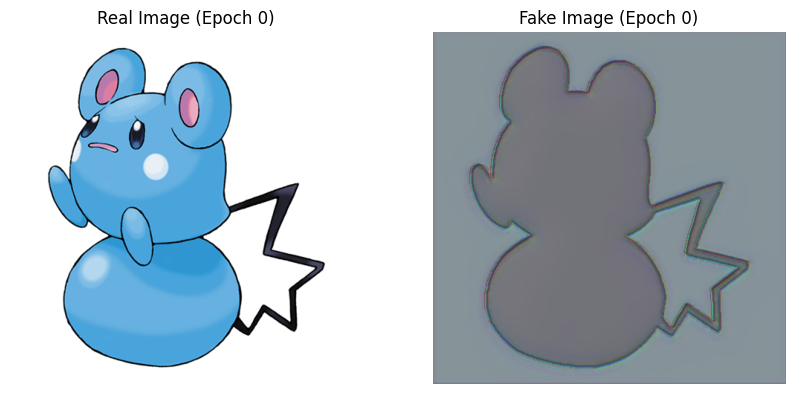

Epoch [101/1500] D_Loss: 0.0035, G_Loss: 33.3191, G_Adv: 23.0259, G_L1: 0.9713, G_Perceptual: 5.3523, G_SSIM: 0.4513


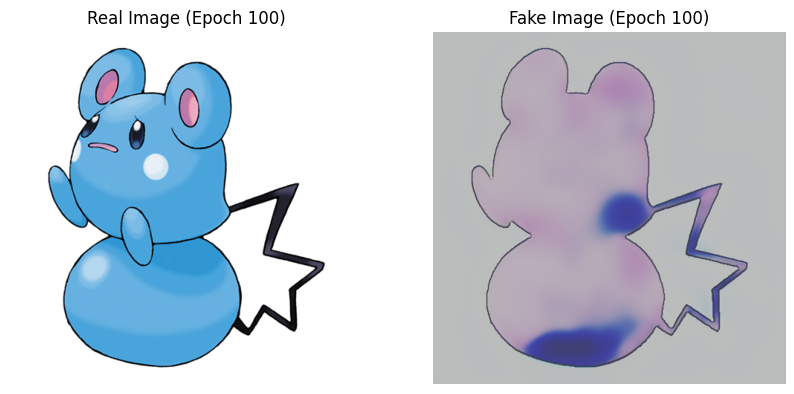

Epoch [201/1500] D_Loss: 0.0003, G_Loss: 31.9413, G_Adv: 23.0259, G_L1: 0.8381, G_Perceptual: 4.9872, G_SSIM: 0.3557


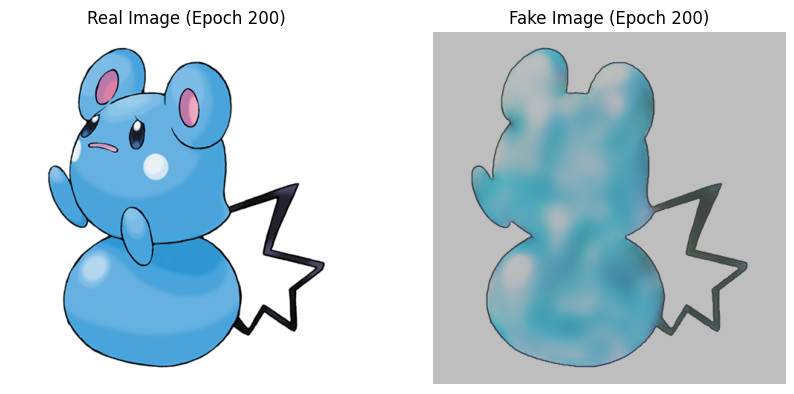

Epoch [301/1500] D_Loss: 0.0001, G_Loss: 31.5632, G_Adv: 23.0259, G_L1: 0.8035, G_Perceptual: 4.6978, G_SSIM: 0.3250


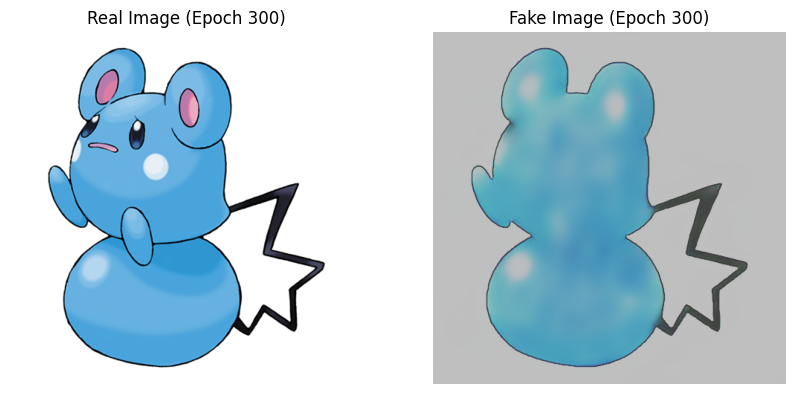

Epoch [401/1500] D_Loss: 0.0001, G_Loss: 31.3566, G_Adv: 23.0259, G_L1: 0.7863, G_Perceptual: 4.3674, G_SSIM: 0.3092


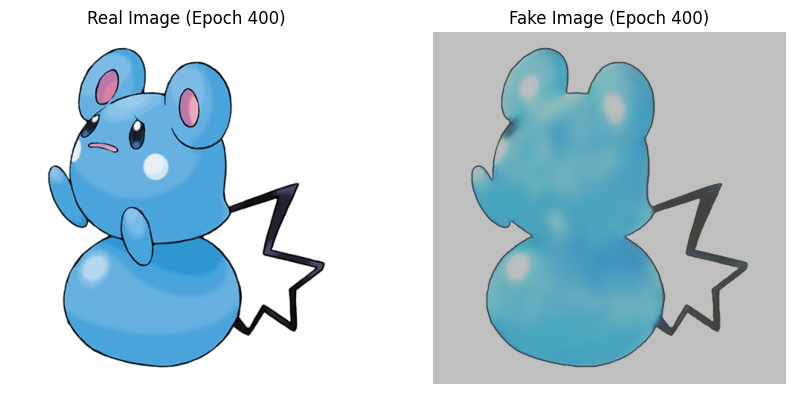

Epoch [501/1500] D_Loss: 0.0000, G_Loss: 31.2898, G_Adv: 23.0259, G_L1: 0.7820, G_Perceptual: 4.1270, G_SSIM: 0.3073


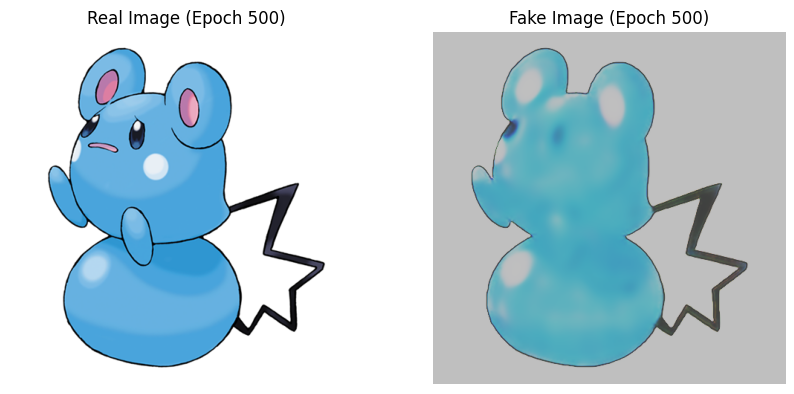

Epoch [601/1500] D_Loss: 0.0000, G_Loss: 31.1416, G_Adv: 23.0259, G_L1: 0.7722, G_Perceptual: 3.6435, G_SSIM: 0.2919


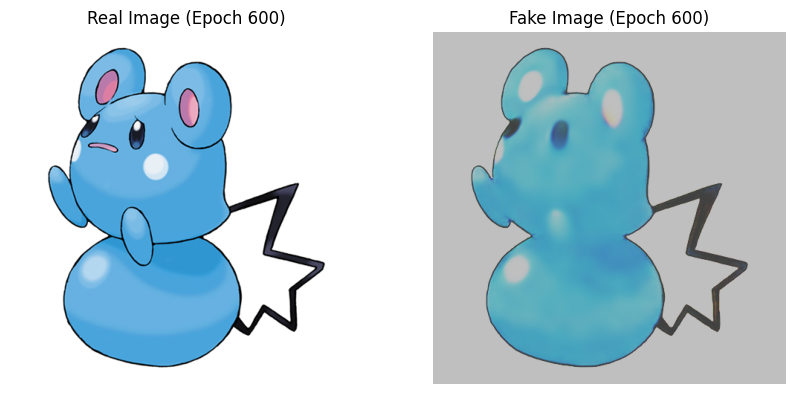

Epoch [701/1500] D_Loss: 0.0000, G_Loss: 31.0513, G_Adv: 23.0259, G_L1: 0.7667, G_Perceptual: 3.3006, G_SSIM: 0.2841


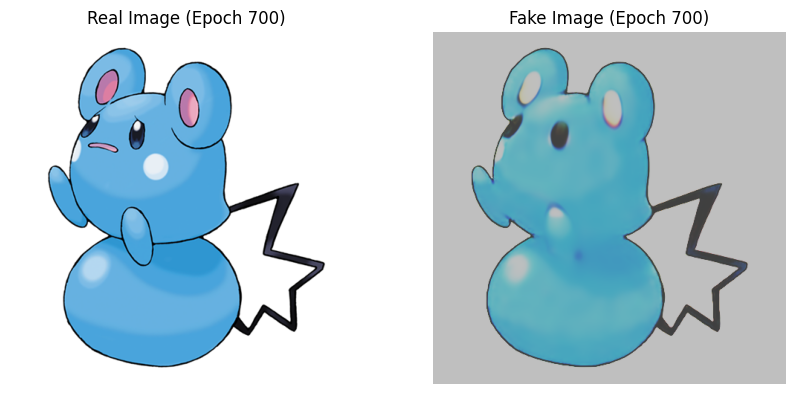

Epoch [801/1500] D_Loss: 0.0000, G_Loss: 30.9726, G_Adv: 23.0259, G_L1: 0.7626, G_Perceptual: 2.9296, G_SSIM: 0.2751


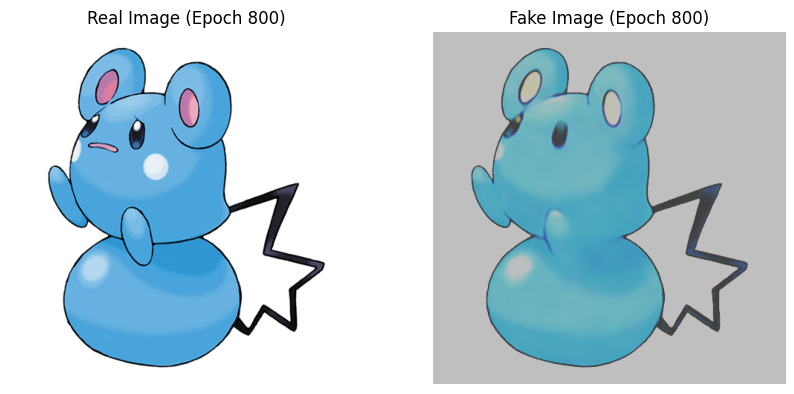

Epoch [901/1500] D_Loss: 0.0000, G_Loss: 30.8746, G_Adv: 23.0259, G_L1: 0.7573, G_Perceptual: 2.4979, G_SSIM: 0.2624


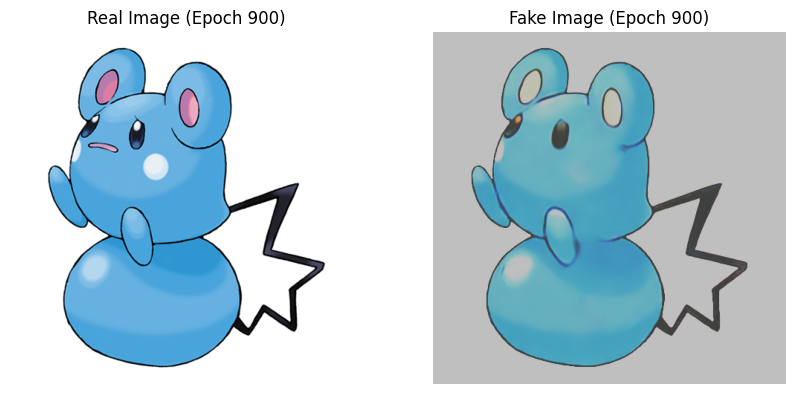

Epoch [1001/1500] D_Loss: 0.0000, G_Loss: 30.8275, G_Adv: 23.0259, G_L1: 0.7558, G_Perceptual: 2.1811, G_SSIM: 0.2559


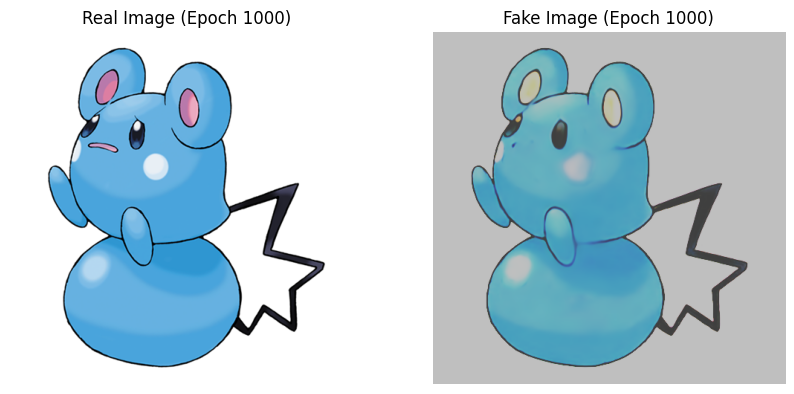

Epoch [1101/1500] D_Loss: 0.0000, G_Loss: 30.7739, G_Adv: 23.0259, G_L1: 0.7530, G_Perceptual: 1.9296, G_SSIM: 0.2521


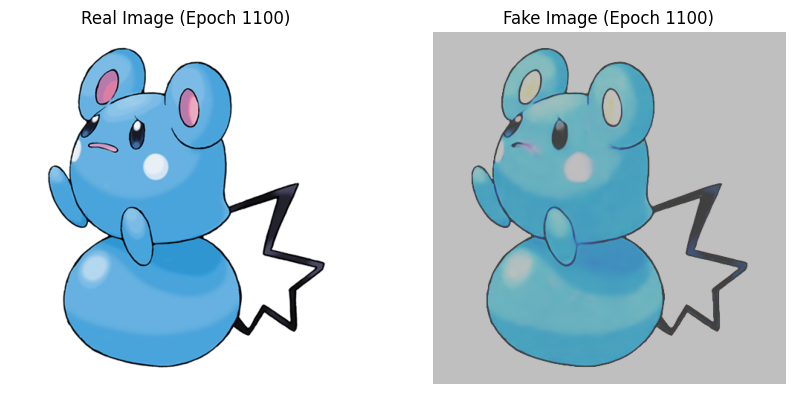

Epoch [1201/1500] D_Loss: 0.0000, G_Loss: 30.7200, G_Adv: 23.0259, G_L1: 0.7498, G_Perceptual: 1.7240, G_SSIM: 0.2423


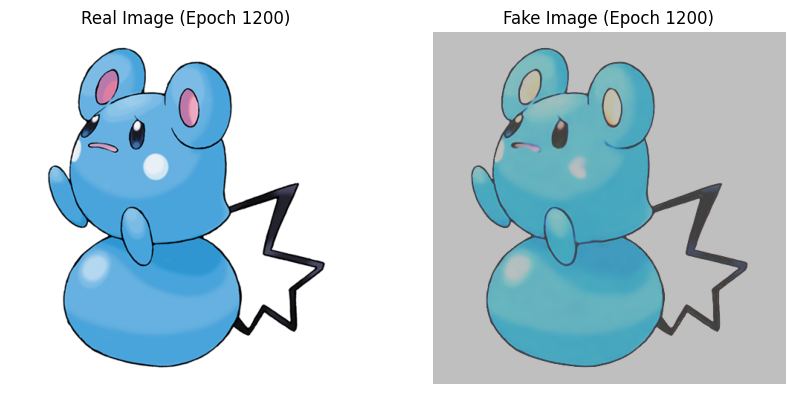

Epoch [1301/1500] D_Loss: 0.0000, G_Loss: 30.6911, G_Adv: 23.0259, G_L1: 0.7482, G_Perceptual: 1.5934, G_SSIM: 0.2399


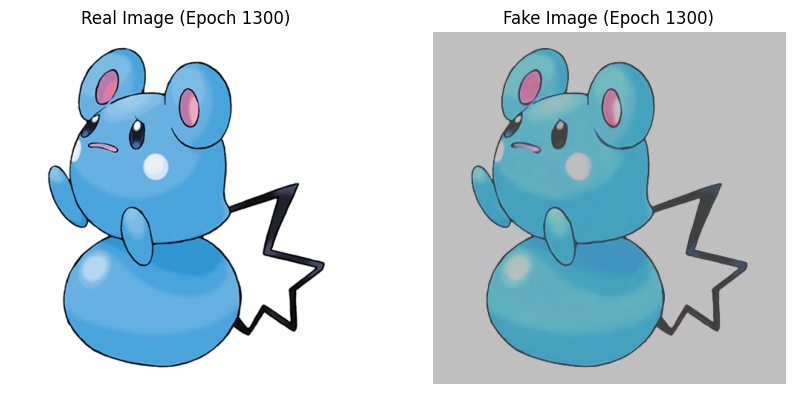

Epoch [1401/1500] D_Loss: 0.0000, G_Loss: 30.6640, G_Adv: 23.0259, G_L1: 0.7469, G_Perceptual: 1.4489, G_SSIM: 0.2395


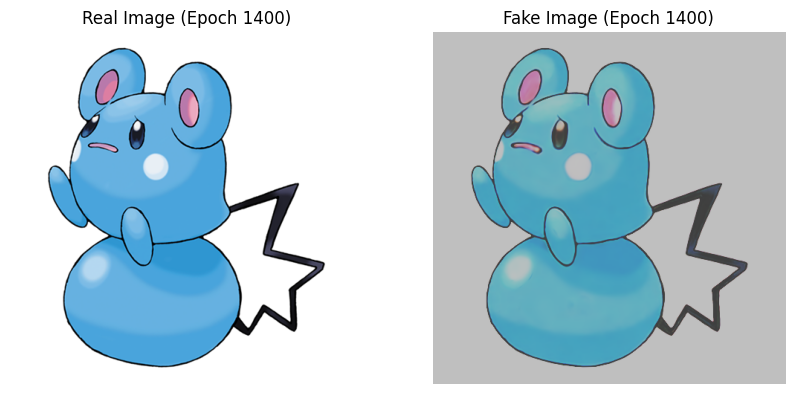

In [ ]:
# Train the GAN model
train_gan(generator, discriminator, dataloader, num_epochs=1500, optimizer_d=optimizer_d, optimizer_g=optimizer_g,  criterion_d=criterion_d, criterion_g=criterion_g, lambda_ssim=0.1)

In [ ]:
# Save the entire model
torch.save(generator, 'generator_full.pth')
torch.save(discriminator, 'discriminator_full.pth')

<ipython-input-11-339c905b4a89>:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator = torch.load("generator_full.pth")


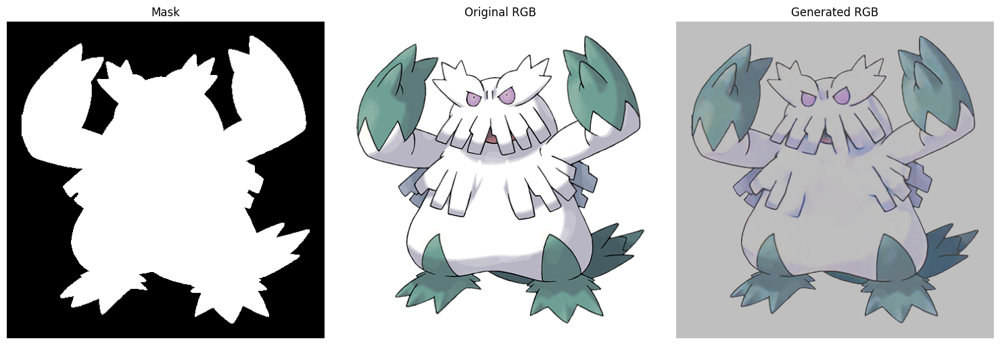

Generated RGB image saved at: output_images/batch_0_sample_0_generated.png


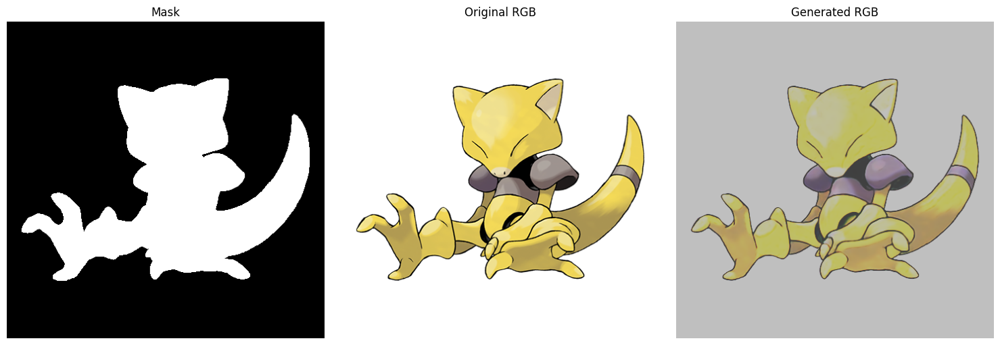

Generated RGB image saved at: output_images/batch_0_sample_1_generated.png


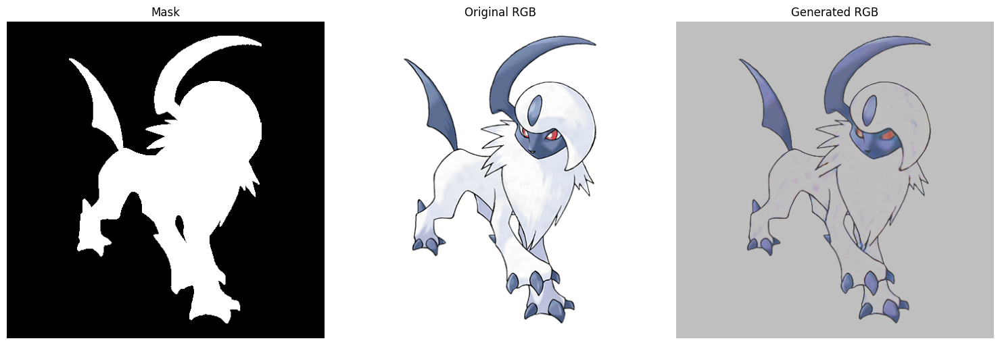

Generated RGB image saved at: output_images/batch_0_sample_2_generated.png


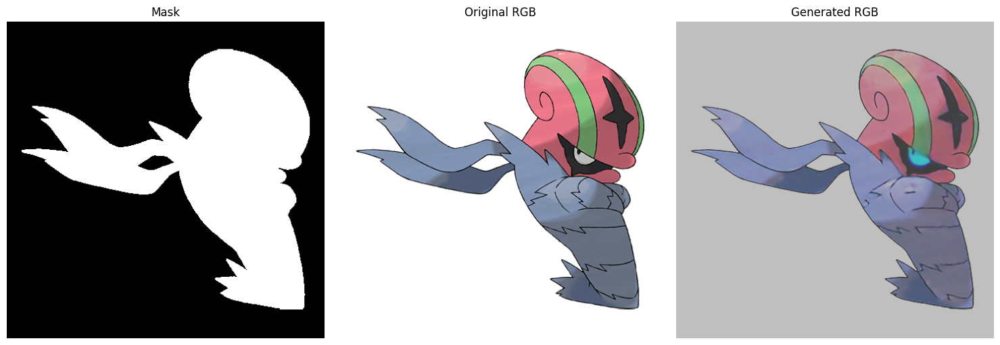

Generated RGB image saved at: output_images/batch_0_sample_3_generated.png


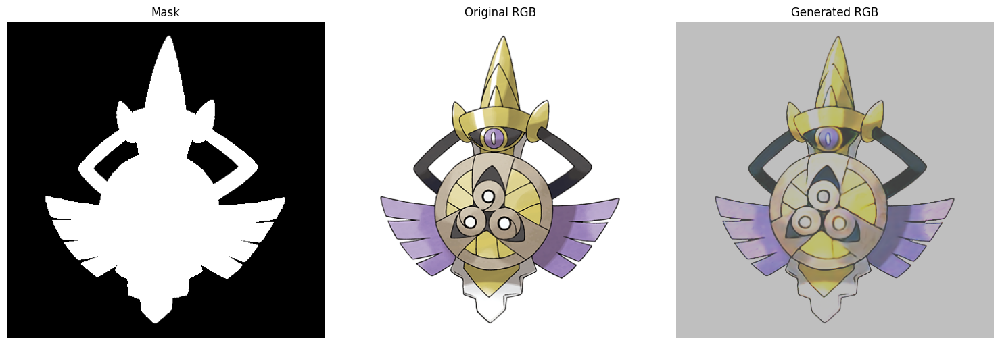

Generated RGB image saved at: output_images/batch_1_sample_0_generated.png


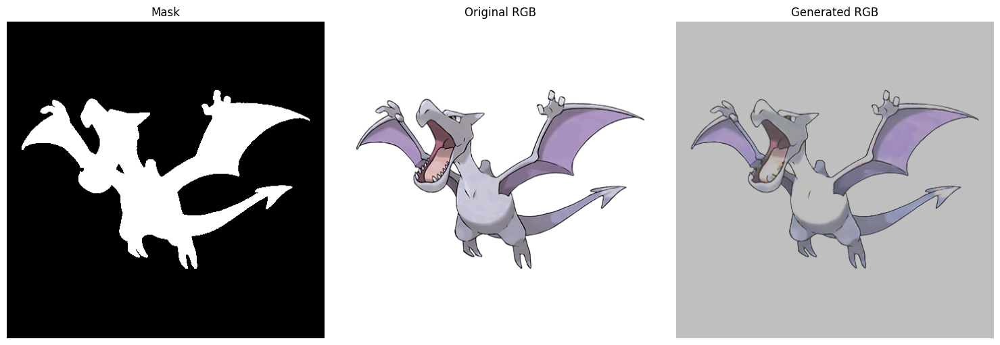

Generated RGB image saved at: output_images/batch_1_sample_1_generated.png


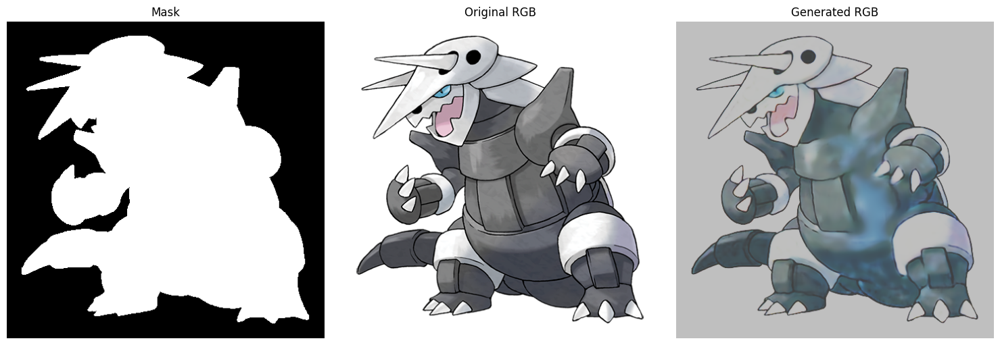

Generated RGB image saved at: output_images/batch_1_sample_2_generated.png


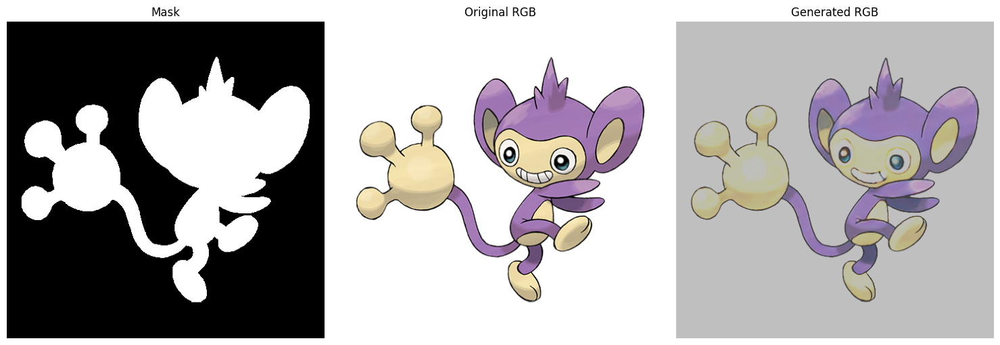

Generated RGB image saved at: output_images/batch_1_sample_3_generated.png


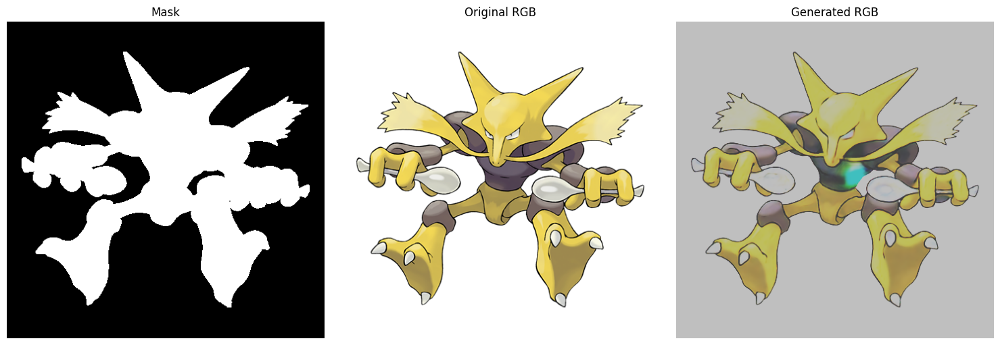

Generated RGB image saved at: output_images/batch_2_sample_0_generated.png


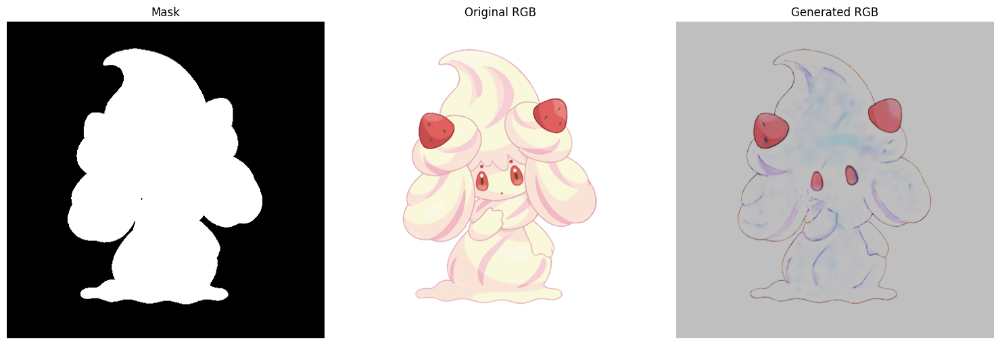

Generated RGB image saved at: output_images/batch_2_sample_1_generated.png


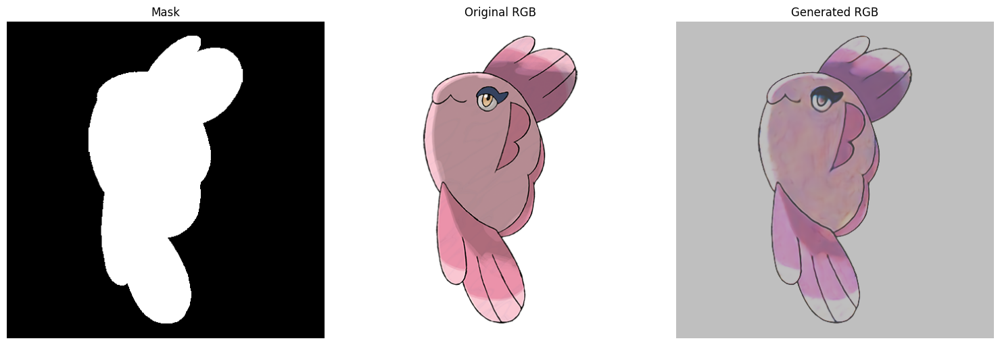

Generated RGB image saved at: output_images/batch_2_sample_2_generated.png


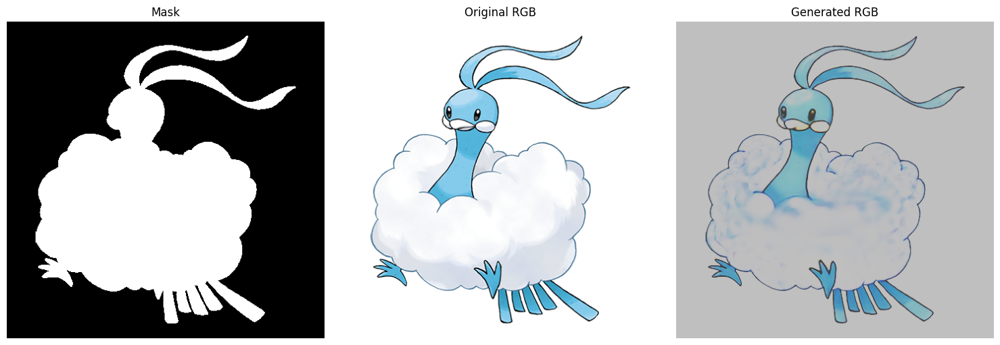

Generated RGB image saved at: output_images/batch_2_sample_3_generated.png


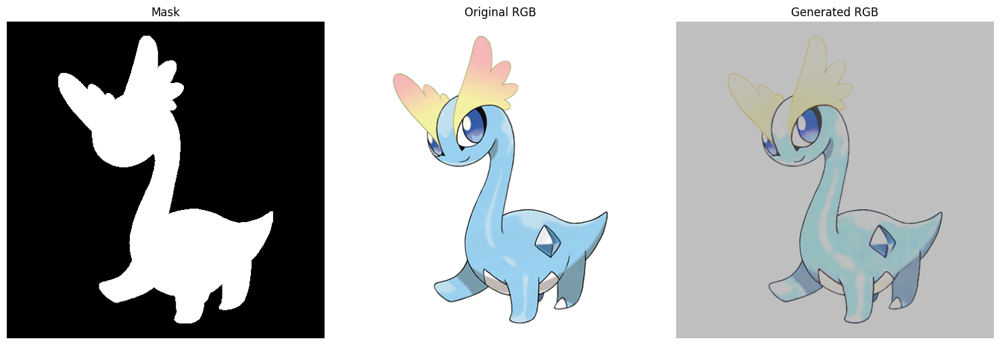

Generated RGB image saved at: output_images/batch_3_sample_0_generated.png


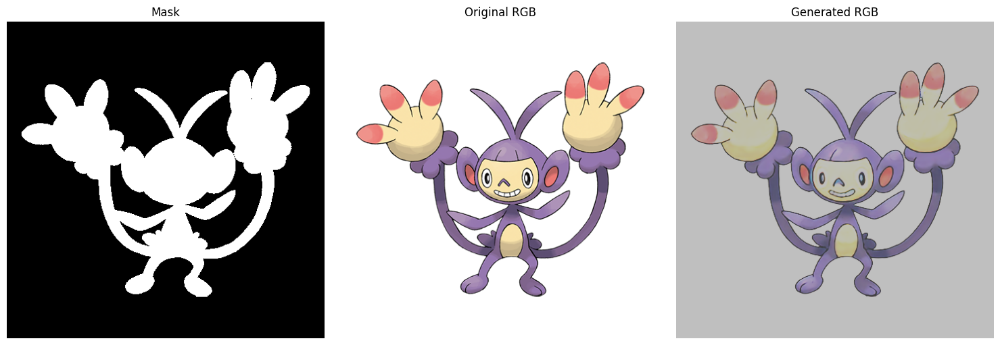

Generated RGB image saved at: output_images/batch_3_sample_1_generated.png


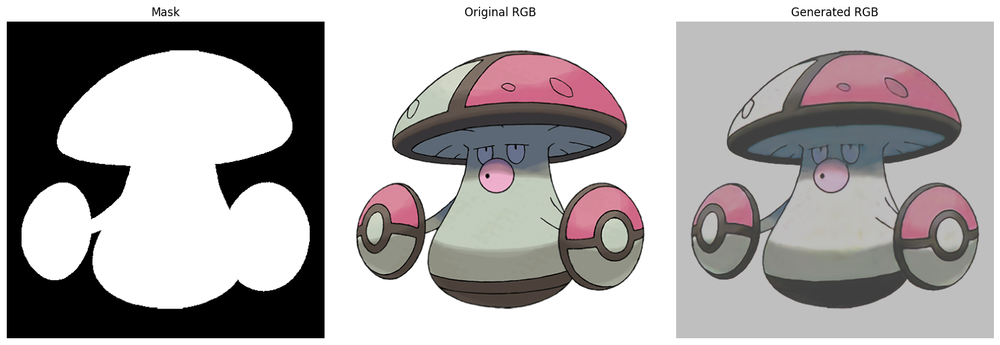

Generated RGB image saved at: output_images/batch_3_sample_2_generated.png


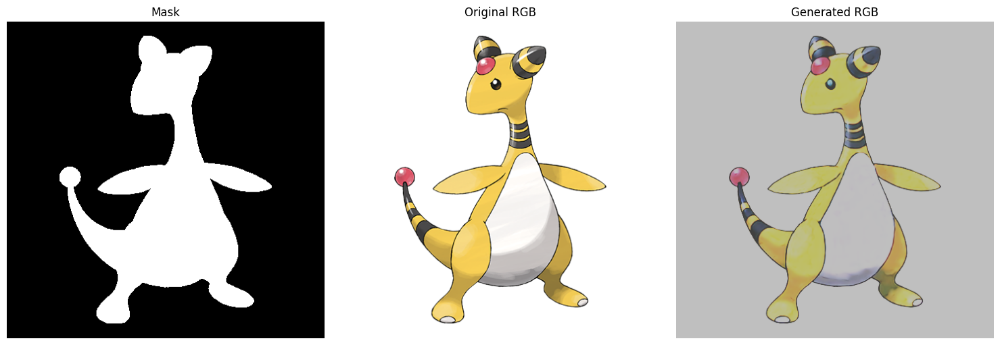

Generated RGB image saved at: output_images/batch_3_sample_3_generated.png


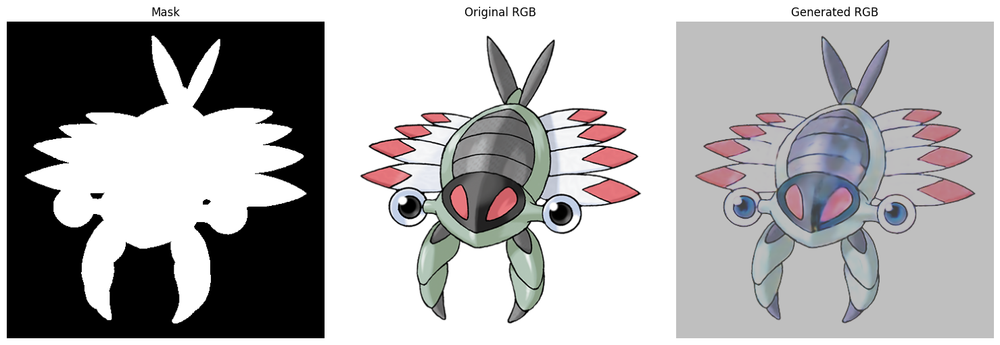

Generated RGB image saved at: output_images/batch_4_sample_0_generated.png


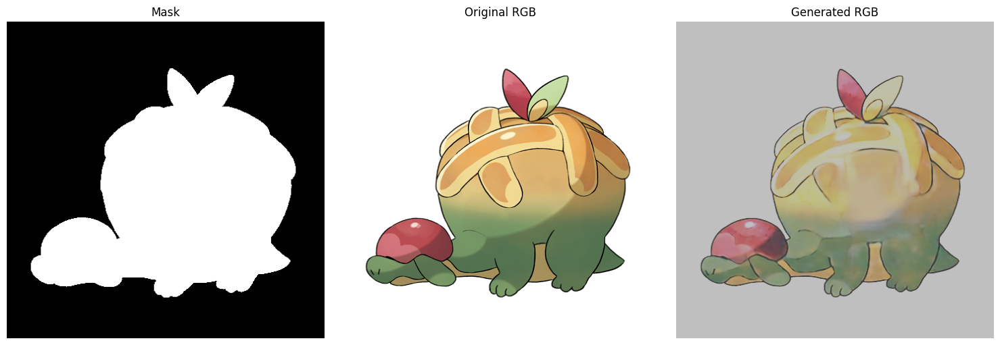

Generated RGB image saved at: output_images/batch_4_sample_1_generated.png


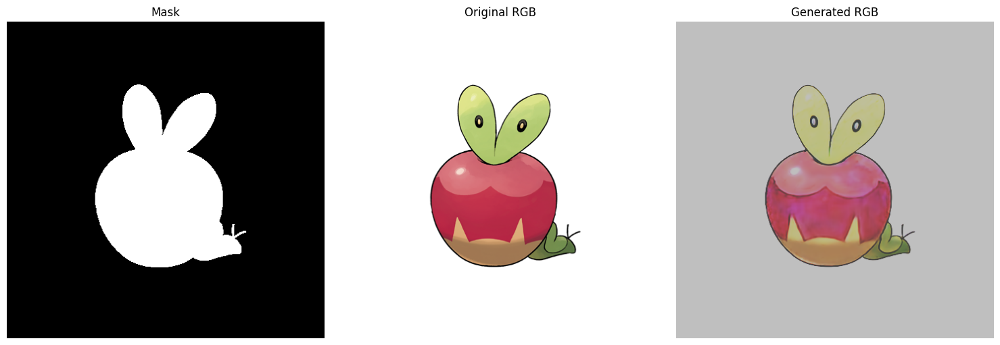

Generated RGB image saved at: output_images/batch_4_sample_2_generated.png


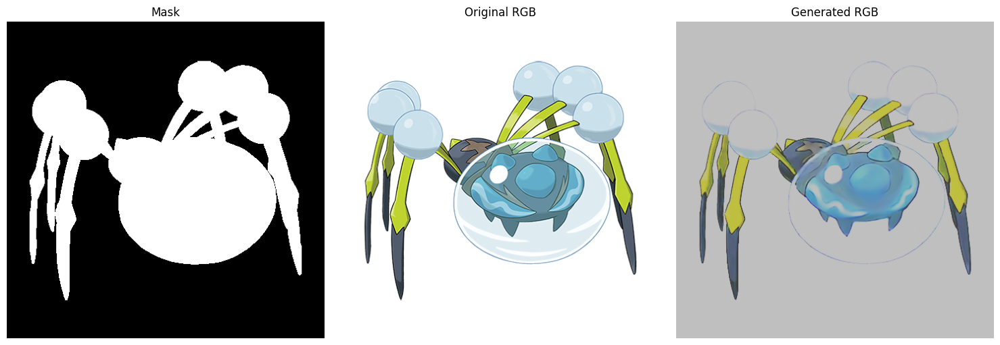

Generated RGB image saved at: output_images/batch_4_sample_3_generated.png


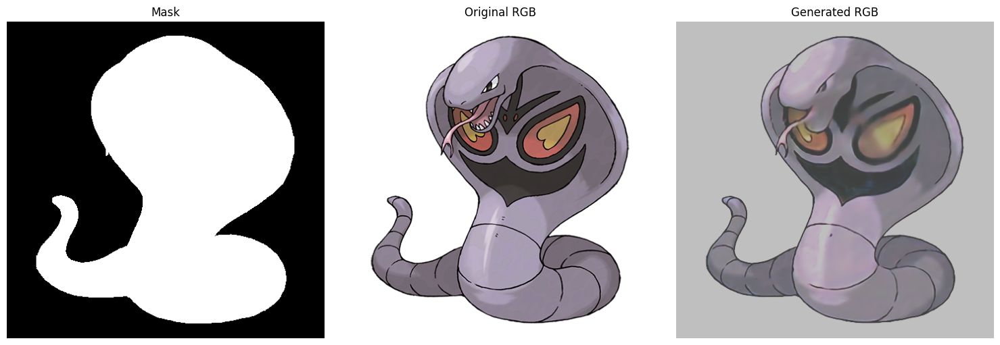

Generated RGB image saved at: output_images/batch_5_sample_0_generated.png


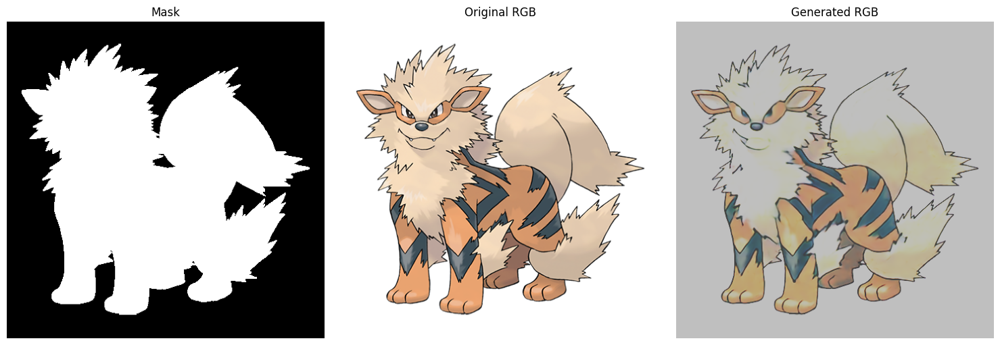

Generated RGB image saved at: output_images/batch_5_sample_1_generated.png


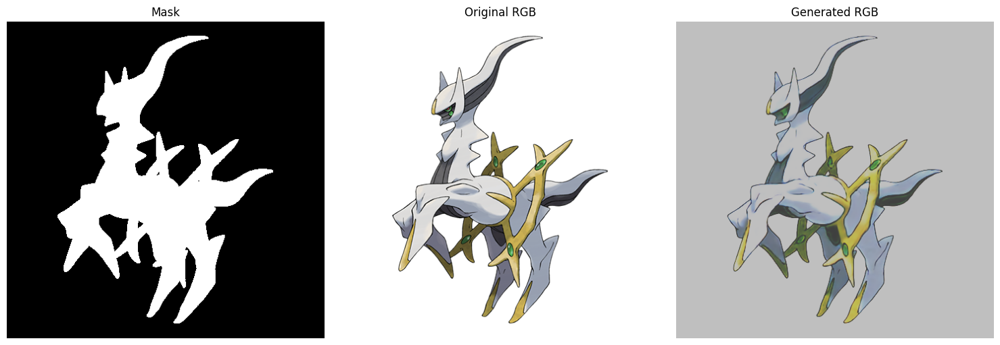

Generated RGB image saved at: output_images/batch_5_sample_2_generated.png


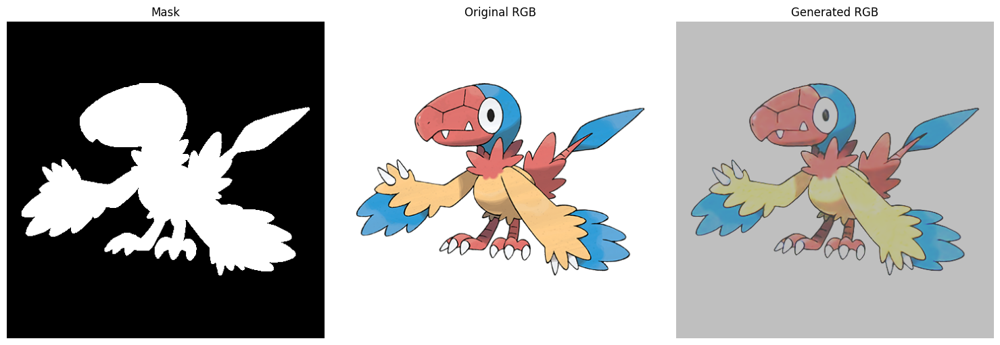

Generated RGB image saved at: output_images/batch_5_sample_3_generated.png


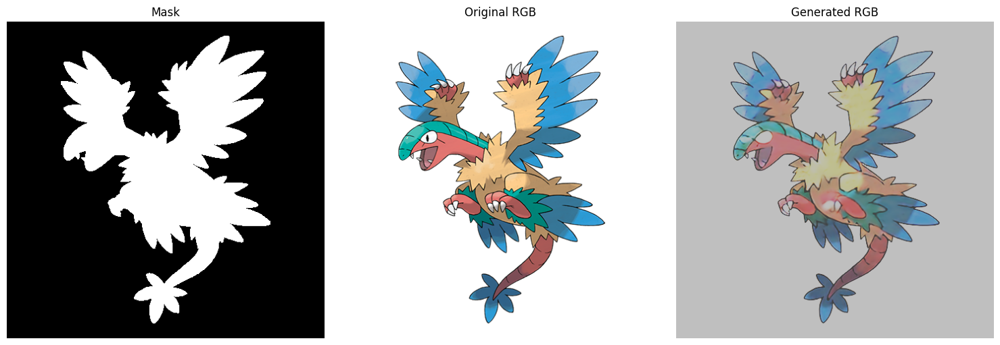

Generated RGB image saved at: output_images/batch_6_sample_0_generated.png


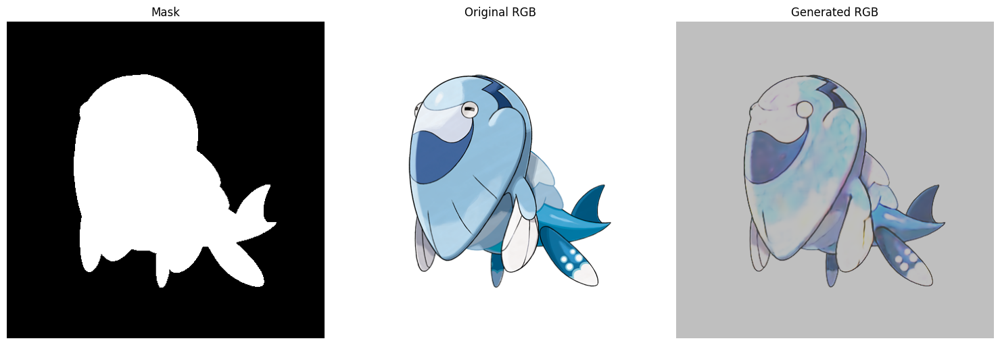

Generated RGB image saved at: output_images/batch_6_sample_1_generated.png


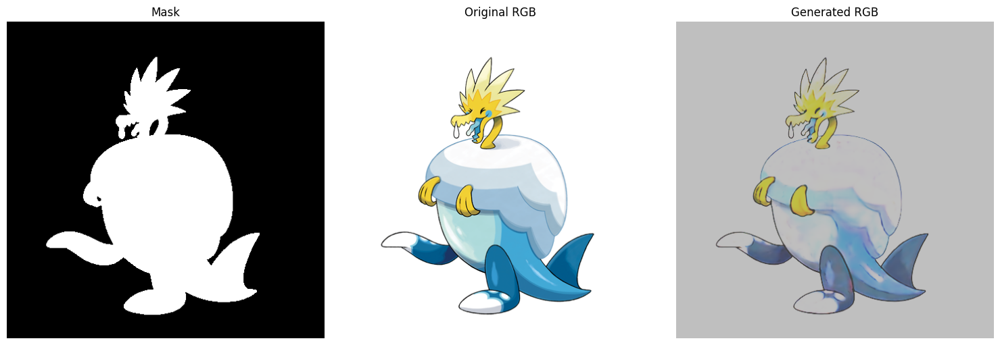

Generated RGB image saved at: output_images/batch_6_sample_2_generated.png


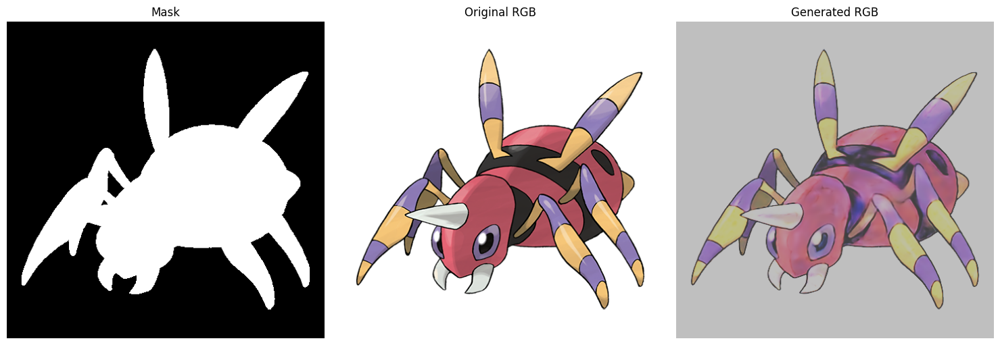

Generated RGB image saved at: output_images/batch_6_sample_3_generated.png


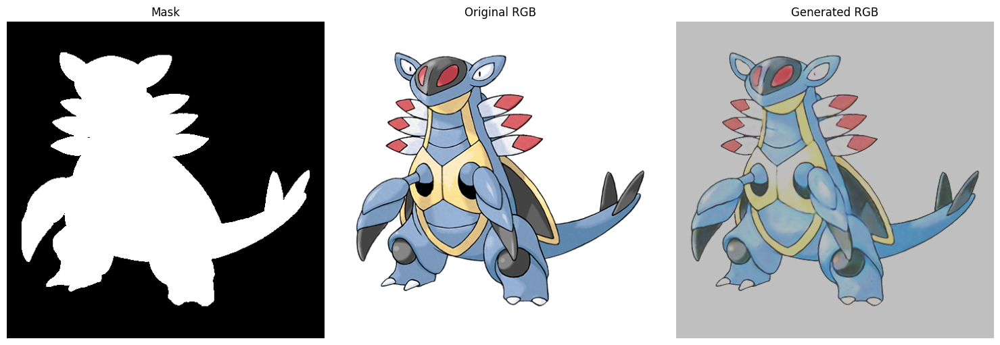

Generated RGB image saved at: output_images/batch_7_sample_0_generated.png


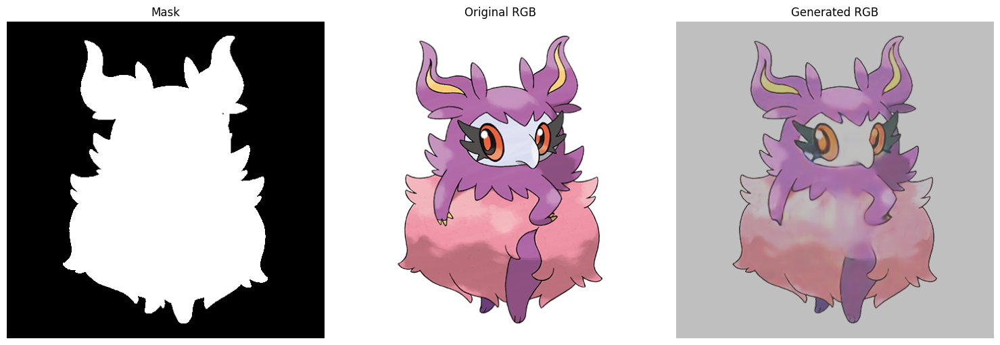

Generated RGB image saved at: output_images/batch_7_sample_1_generated.png


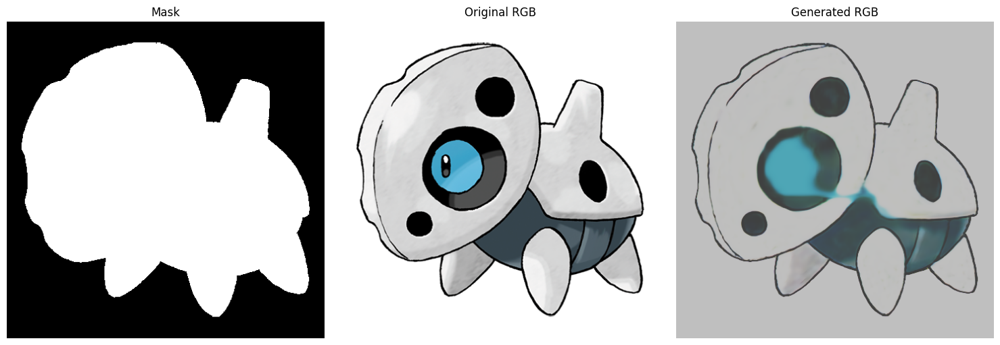

Generated RGB image saved at: output_images/batch_7_sample_2_generated.png


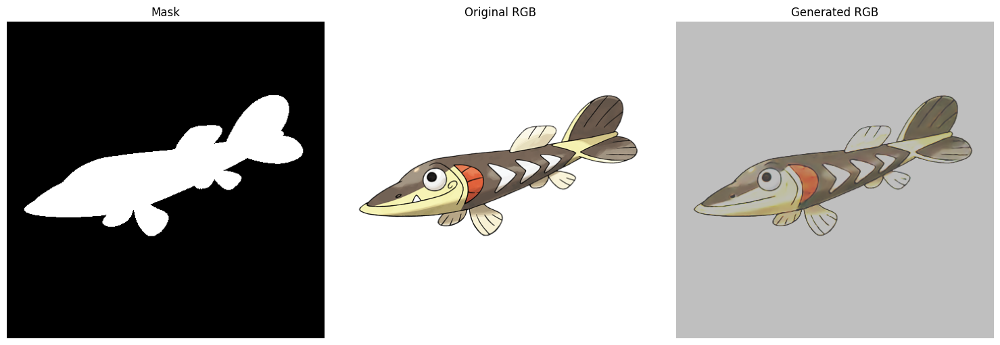

Generated RGB image saved at: output_images/batch_7_sample_3_generated.png


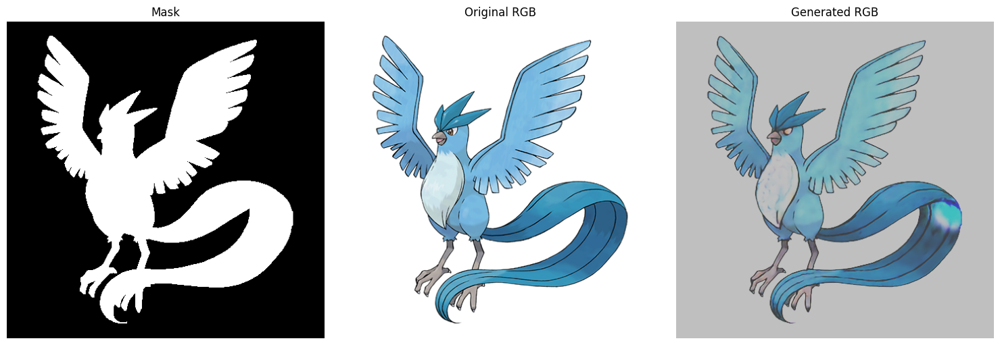

Generated RGB image saved at: output_images/batch_8_sample_0_generated.png


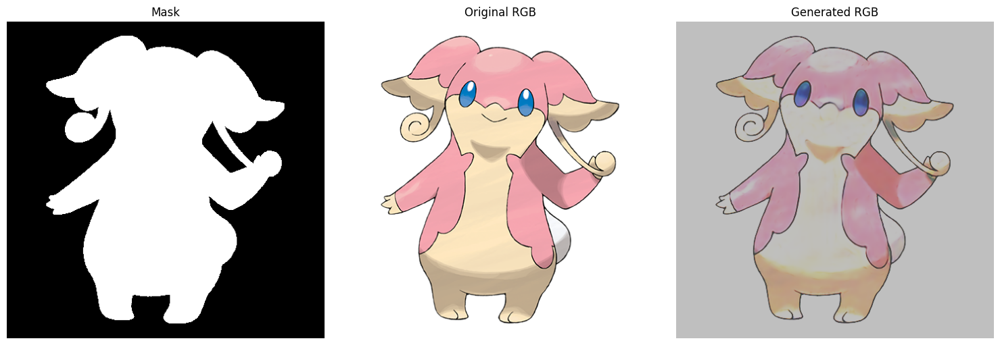

Generated RGB image saved at: output_images/batch_8_sample_1_generated.png


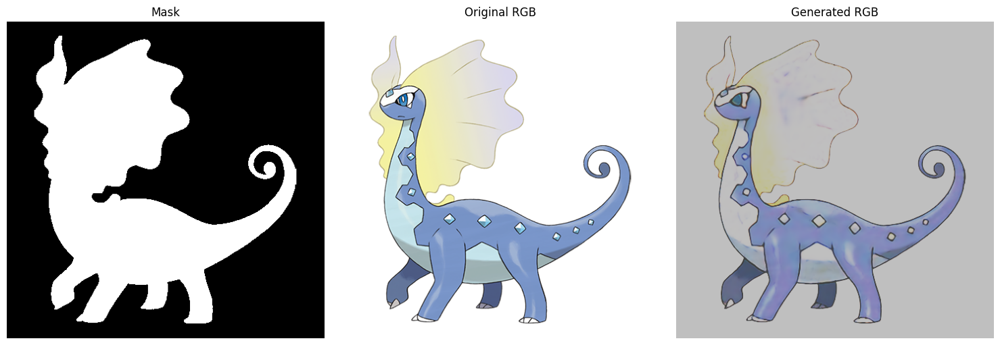

Generated RGB image saved at: output_images/batch_8_sample_2_generated.png


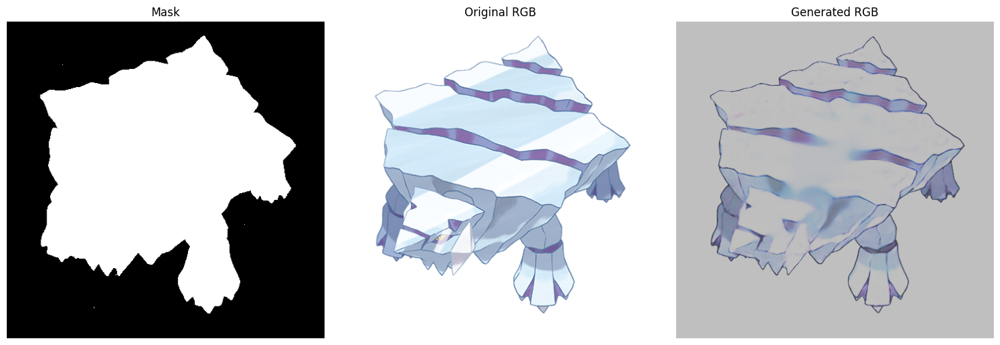

Generated RGB image saved at: output_images/batch_8_sample_3_generated.png


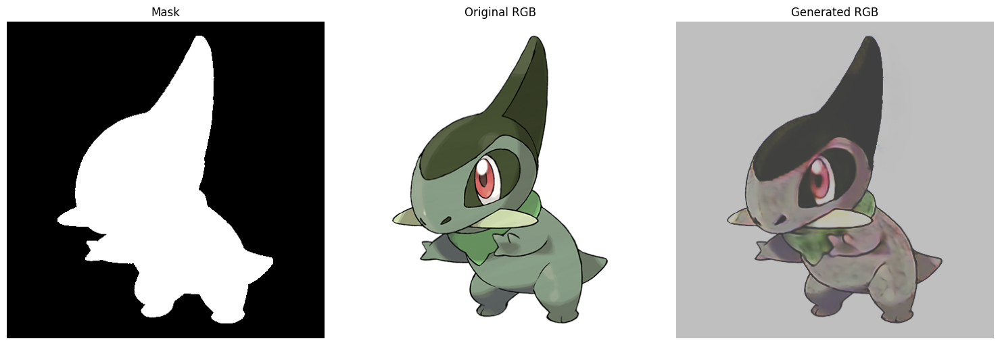

Generated RGB image saved at: output_images/batch_9_sample_0_generated.png


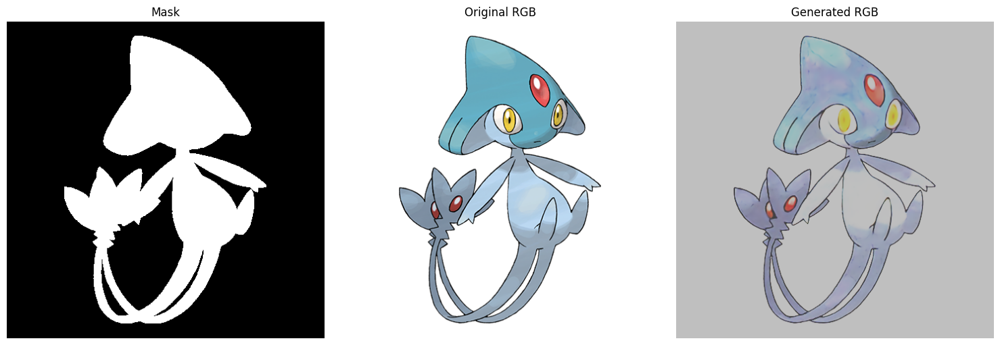

Generated RGB image saved at: output_images/batch_9_sample_1_generated.png


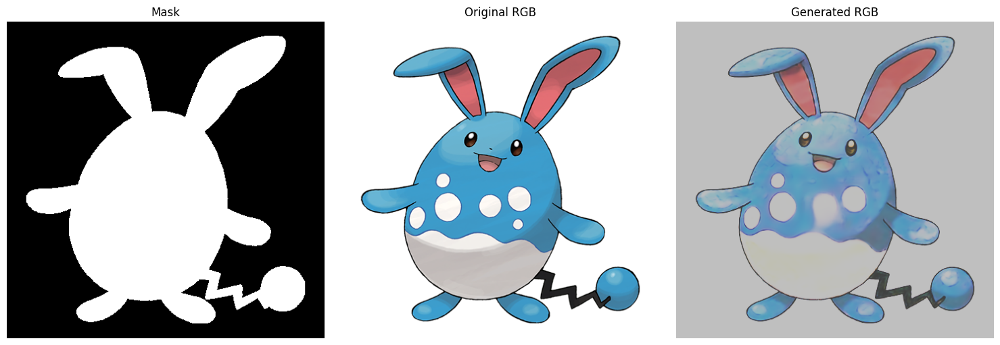

Generated RGB image saved at: output_images/batch_9_sample_2_generated.png


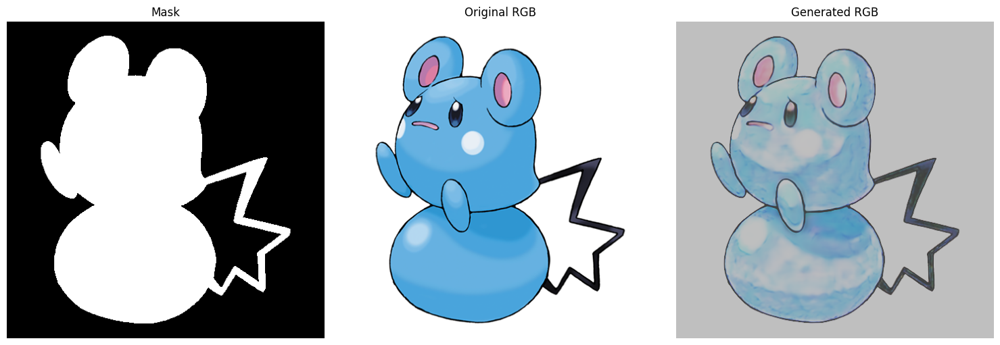

Generated RGB image saved at: output_images/batch_9_sample_3_generated.png


In [ ]:
# Load the .mat file
import os

# generator = UNetGenerator(input_channels=3, output_channels=3)

generator = torch.load("generator_full.pth")

generator.to(device)
generator.eval()
# Function to prepare images for plotting
# Function to prepare and denormalize images for plotting
def denormalize_and_clip(tensor, mean, std):
    """
    Denormalizes a tensor, scales to [0, 255], and clips to valid range.

    Args:
        tensor (torch.Tensor): Normalized image tensor of shape (C, H, W).
        mean (list or tuple): Mean used during normalization (list of length C).
        std (list or tuple): Std used during normalization (list of length C).

    Returns:
        numpy.ndarray: Denormalized and scaled image of shape (H, W, C), dtype=uint8.
    """
    denormalized = tensor.clone()  # Avoid modifying the original tensor
    for t, m, s in zip(denormalized, mean, std):
        t.mul_(s).add_(m)  # Reverse normalization: multiply by std and add mean

    # Scale to [0, 255] and clamp to valid range
    denormalized = (denormalized * 255).clamp(0, 255)

    # Convert to NumPy and permute to (H, W, C)
    return denormalized.permute(1, 2, 0).byte().cpu().numpy()



# Plotting function
def plot_sample(mask, rgb, generated_rgb):
    """
    Plots the original mask, RGB image, and generated RGB image.

    Args:
        mask (torch.Tensor): Grayscale mask of shape (1, H, W).
        rgb (torch.Tensor): Original RGB image of shape (3, H, W).
        generated_rgb (torch.Tensor): Generated RGB image of shape (3, H, W).
    """
    # Prepare the images for plotting
    mask_np = mask[0].cpu().numpy()*255  # Extract mask channel  
    
    # Denormalize and prepare the images
    mean = [0.5, 0.5, 0.5]
    std = [0.25, 0.25, 0.25]
    rgb_np = denormalize_and_clip(rgb, mean, std)
    generated_rgb_np  = denormalize_and_clip(generated_rgb, mean, std)
    # Convert NumPy array to PIL image
    # Plot the images
    plt.figure(figsize=(15, 5))

    # Mask
    plt.subplot(1, 3, 1)
    plt.imshow(mask_np, cmap='gray')
    plt.title("Mask")
    plt.axis("off")

    # Original RGB
    plt.subplot(1, 3, 2)
    plt.imshow(rgb_np)
    plt.title("Original RGB")
    plt.axis("off")

    # Generated RGB
    plt.subplot(1, 3, 3)
    plt.imshow(generated_rgb_np)
    plt.title("Generated RGB")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

def save_generated_rgb(generated_rgb, batch_idx, sample_idx, output_dir="output_images"):
    """
    Saves the generated RGB image to a file.

    Args:
        generated_rgb (torch.Tensor): Generated RGB image of shape (3, H, W).
        batch_idx (int): Batch index.
        sample_idx (int): Sample index within the batch.
        output_dir (str): Directory to save the image files.
    """
    # Denormalize and prepare the images
    mean = [0.5, 0.5, 0.5]
    std = [0.25, 0.25, 0.25]
    generated_rgb_np  = denormalize_and_clip(generated_rgb, mean, std)
    # Create the output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    # Convert the NumPy array to a PIL Image
    image = Image.fromarray(generated_rgb_np)
    output_path = os.path.join(output_dir, f"batch_{batch_idx}_sample_{sample_idx}_generated.png")
    image.save(output_path)
    # Save the image as a PNG file
    print(f"Generated RGB image saved at: {output_path}")
    
# Process 10 batches, each with 4 samples
batch_size = 4
num_batches = 10
output_directory = "output_images"  # Directory to save the images

# Iterate through train_loader to process 10 batches
for batch_idx, (masks_batch, rgbs_batch) in enumerate(dataloader):
    if batch_idx >= 11:  # Stop after processing 10 batches
        break

    # Move the batch data to the device
    masks_batch = masks_batch.to(device)  # Shape: (batch_size, C, H, W)
    rgbs_batch = rgbs_batch.to(device)   # Shape: (batch_size, C, H, W)

    # Process each sample in the batch
    for sample_idx in range(masks_batch.size(0)):  # Loop over the batch size
        with torch.no_grad():
            # Remove batch dimension
            test_mask = masks_batch[sample_idx].unsqueeze(0)  # Add batch dimension
            test_rgb = rgbs_batch[sample_idx].unsqueeze(0)    # Add batch dimension
            generated_rgb = generator(test_mask).squeeze(0)   # Remove batch dimension
        
        plot_sample(test_mask.squeeze(0), test_rgb.squeeze(0), generated_rgb)
        
        # Save only the generated RGB image
        save_generated_rgb(
            generated_rgb, 
            batch_idx, 
            sample_idx, 
            output_dir=output_directory
        )

<ipython-input-12-c01fdc6003bd>:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator = torch.load("generator_full.pth")


SSIM: 0.8820


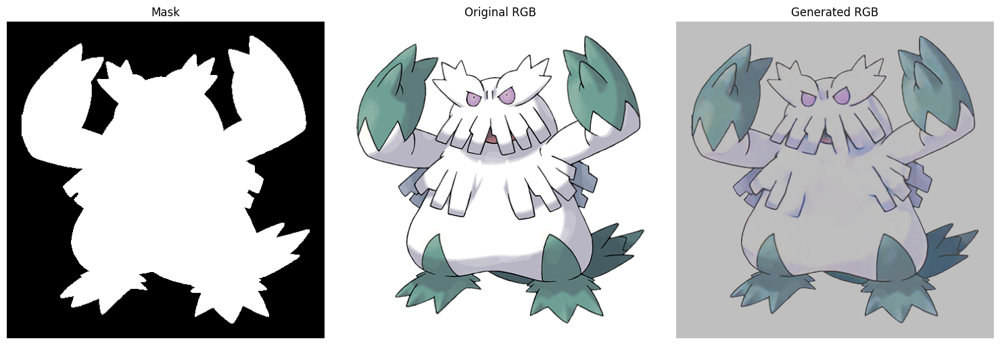

Generated RGB image saved at: output_images/batch_0_sample_0_generated.png
SSIM: 0.9183


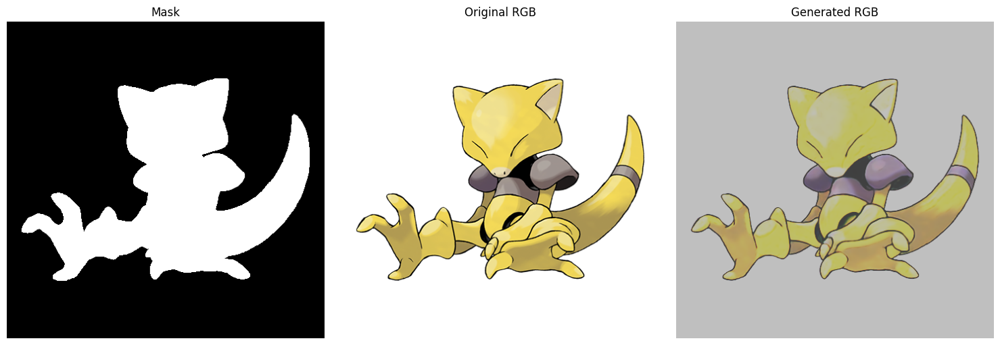

Generated RGB image saved at: output_images/batch_0_sample_1_generated.png
SSIM: 0.9217


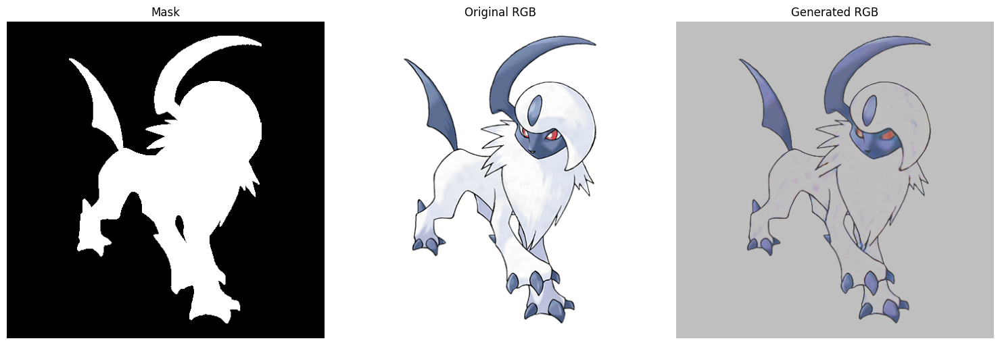

Generated RGB image saved at: output_images/batch_0_sample_2_generated.png
SSIM: 0.9144


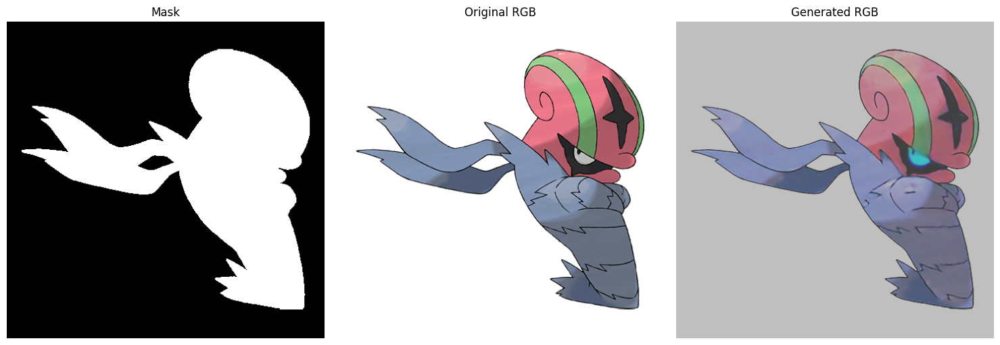

Generated RGB image saved at: output_images/batch_0_sample_3_generated.png
SSIM: 0.9034


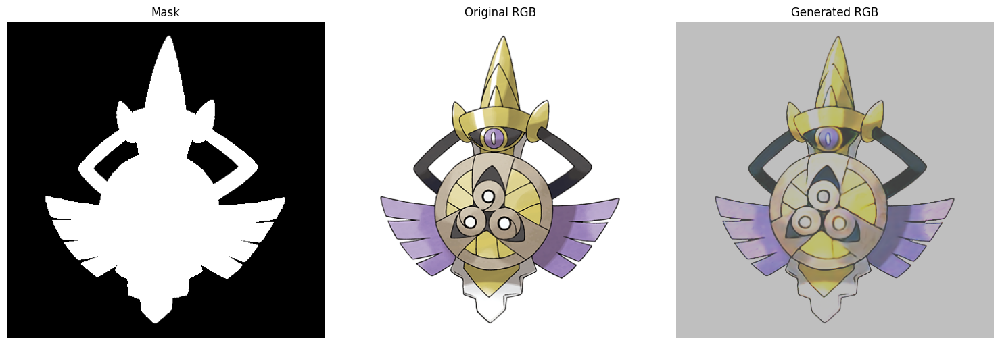

Generated RGB image saved at: output_images/batch_1_sample_0_generated.png
SSIM: 0.9380


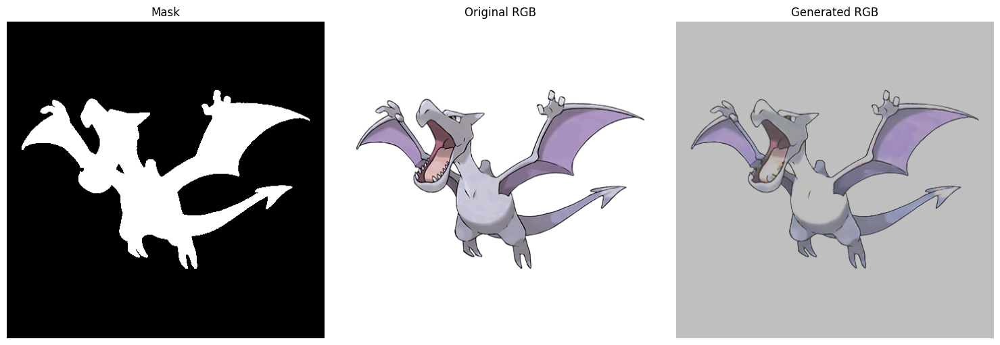

Generated RGB image saved at: output_images/batch_1_sample_1_generated.png
SSIM: 0.8226


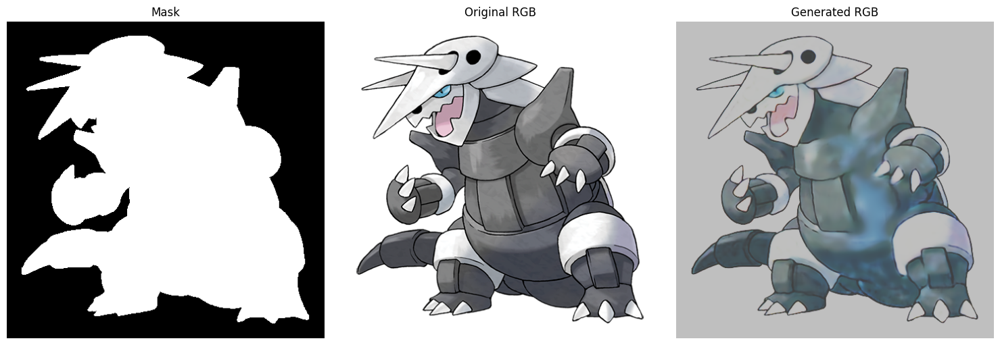

Generated RGB image saved at: output_images/batch_1_sample_2_generated.png
SSIM: 0.9139


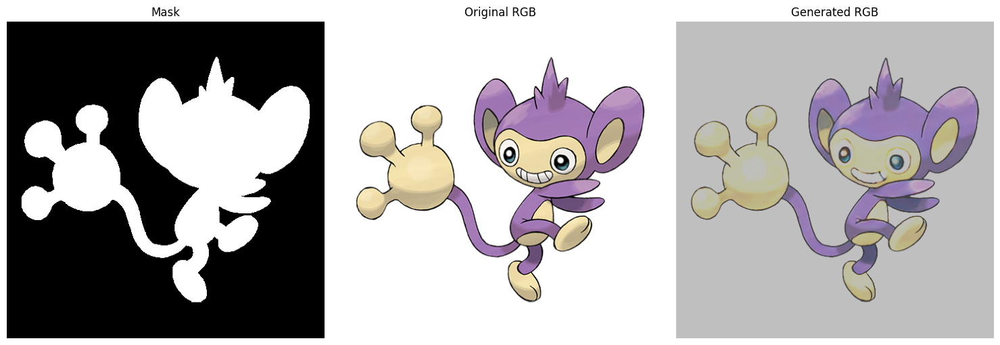

Generated RGB image saved at: output_images/batch_1_sample_3_generated.png
SSIM: 0.8988


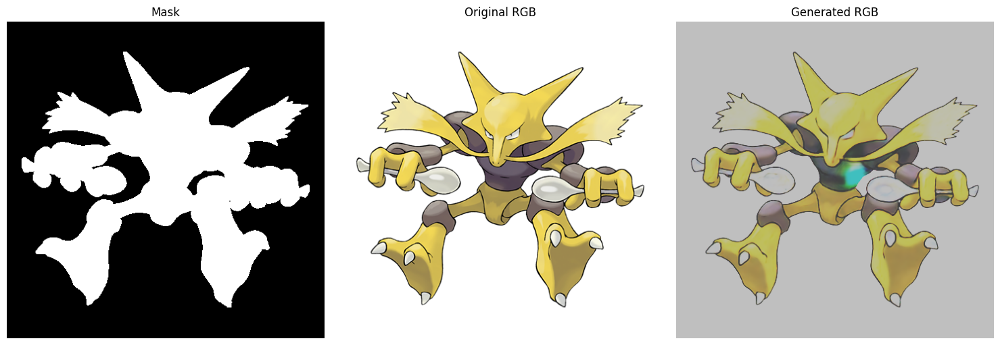

Generated RGB image saved at: output_images/batch_2_sample_0_generated.png
SSIM: 0.8942


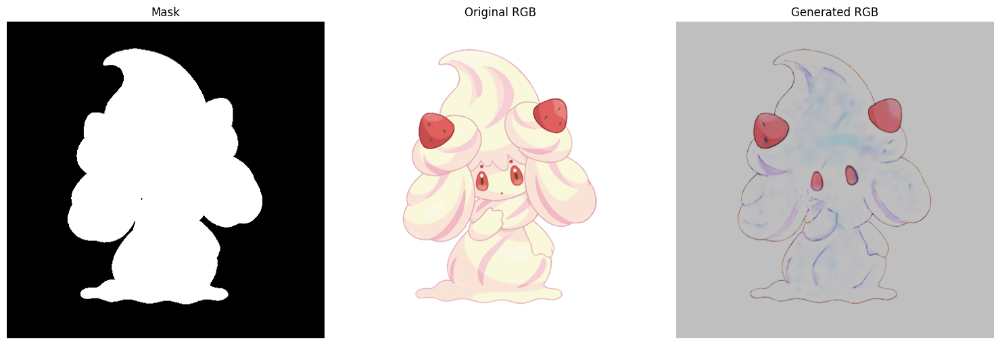

Generated RGB image saved at: output_images/batch_2_sample_1_generated.png
SSIM: 0.9315


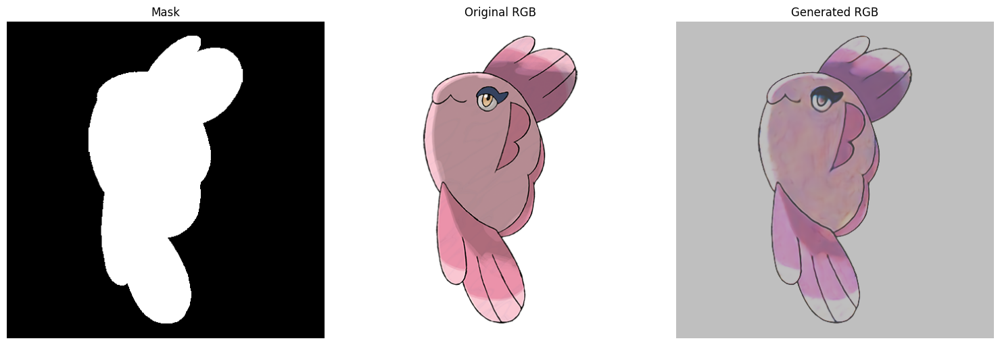

Generated RGB image saved at: output_images/batch_2_sample_2_generated.png
SSIM: 0.9102


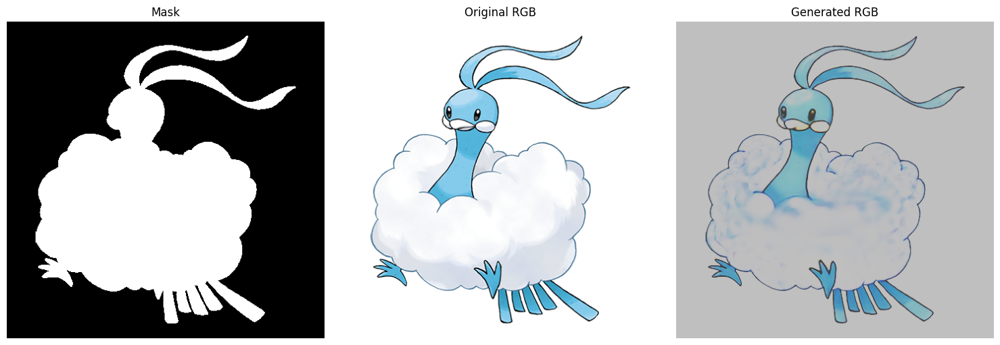

Generated RGB image saved at: output_images/batch_2_sample_3_generated.png
SSIM: 0.9256


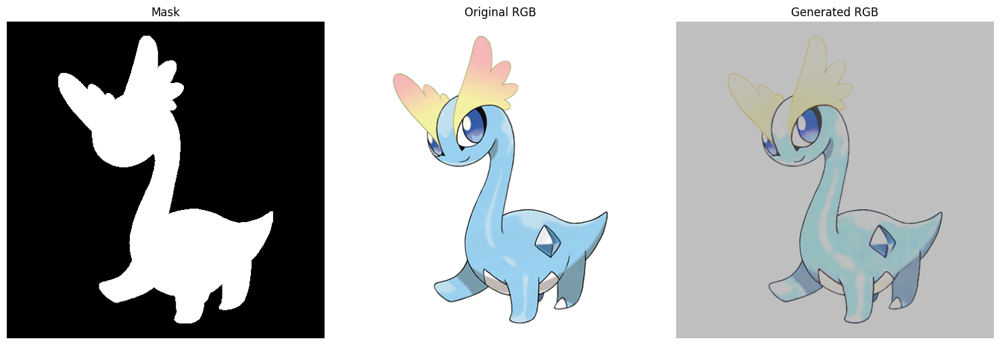

Generated RGB image saved at: output_images/batch_3_sample_0_generated.png
SSIM: 0.9202


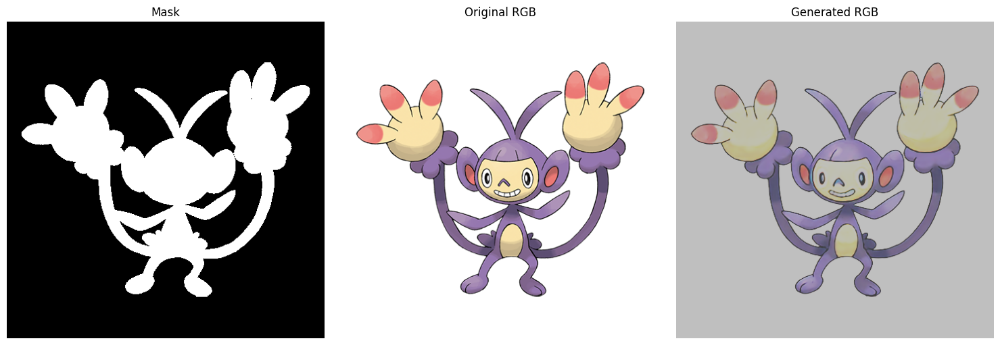

Generated RGB image saved at: output_images/batch_3_sample_1_generated.png
SSIM: 0.8923


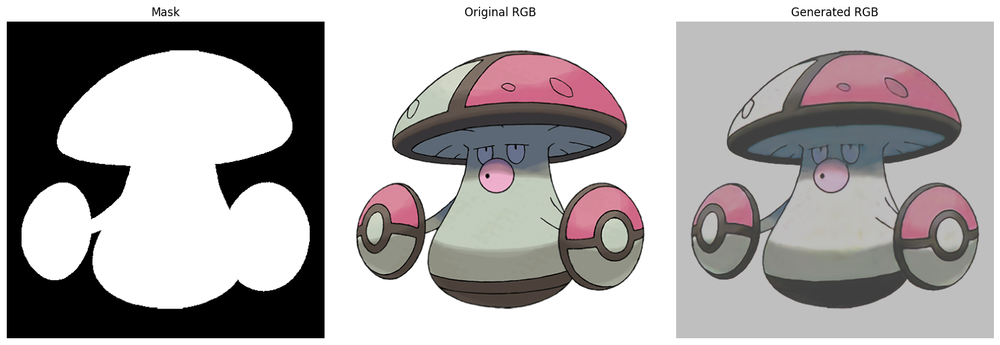

Generated RGB image saved at: output_images/batch_3_sample_2_generated.png
SSIM: 0.9247


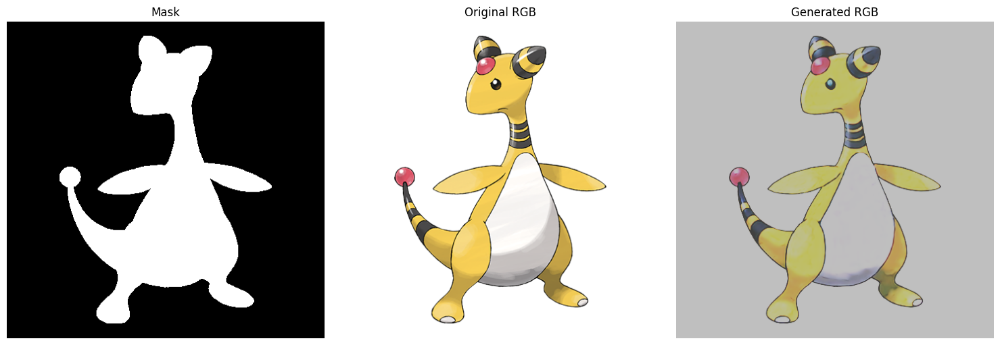

Generated RGB image saved at: output_images/batch_3_sample_3_generated.png
SSIM: 0.8747


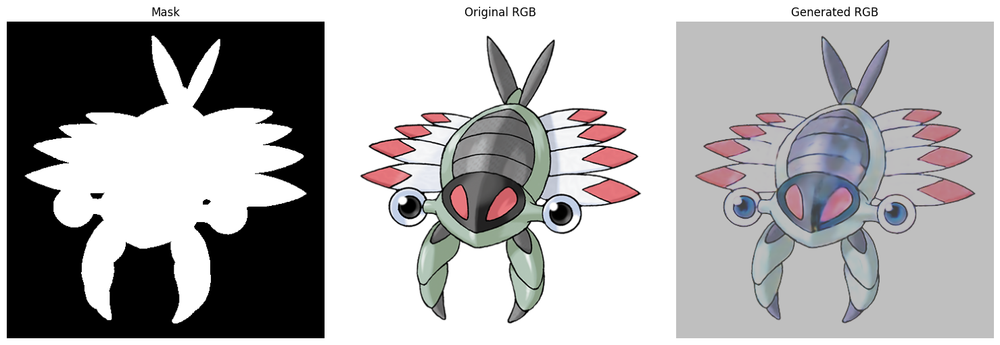

Generated RGB image saved at: output_images/batch_4_sample_0_generated.png
SSIM: 0.8869


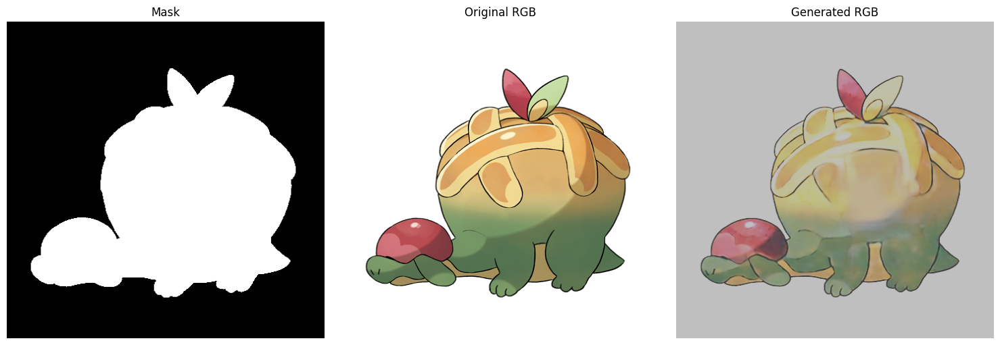

Generated RGB image saved at: output_images/batch_4_sample_1_generated.png
SSIM: 0.9319


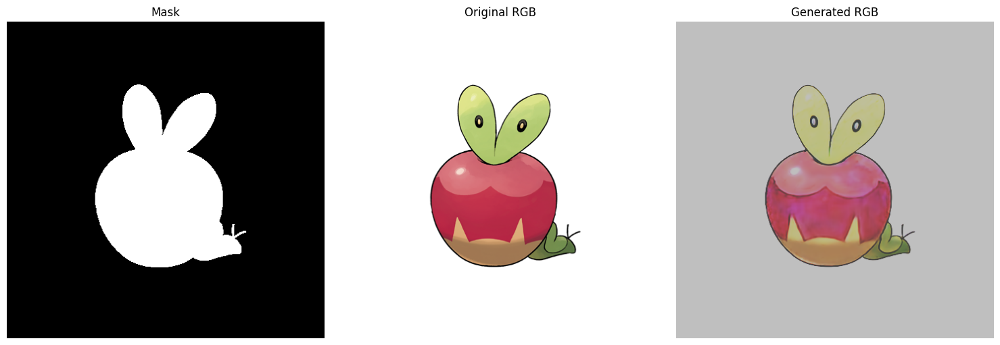

Generated RGB image saved at: output_images/batch_4_sample_2_generated.png
SSIM: 0.8553


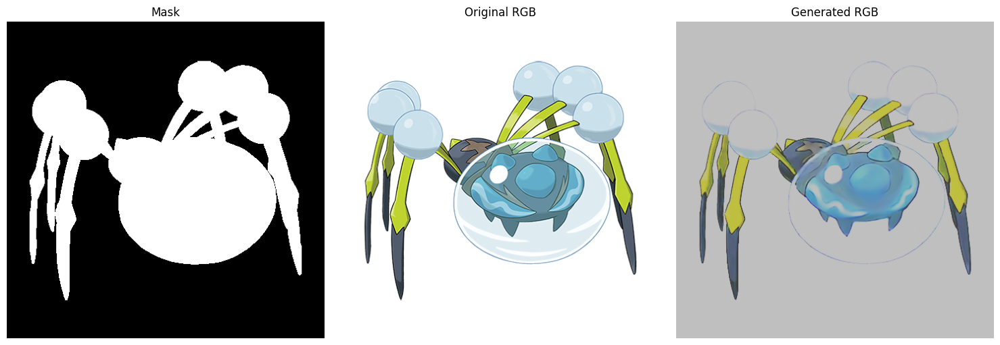

Generated RGB image saved at: output_images/batch_4_sample_3_generated.png
SSIM: 0.8627


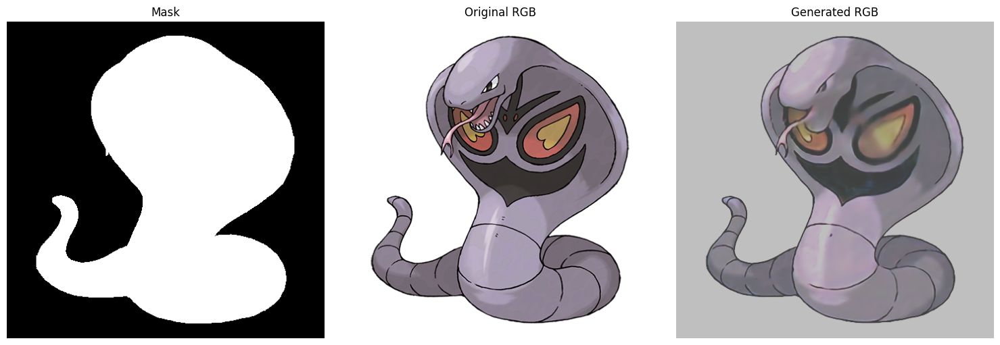

Generated RGB image saved at: output_images/batch_5_sample_0_generated.png
SSIM: 0.8885


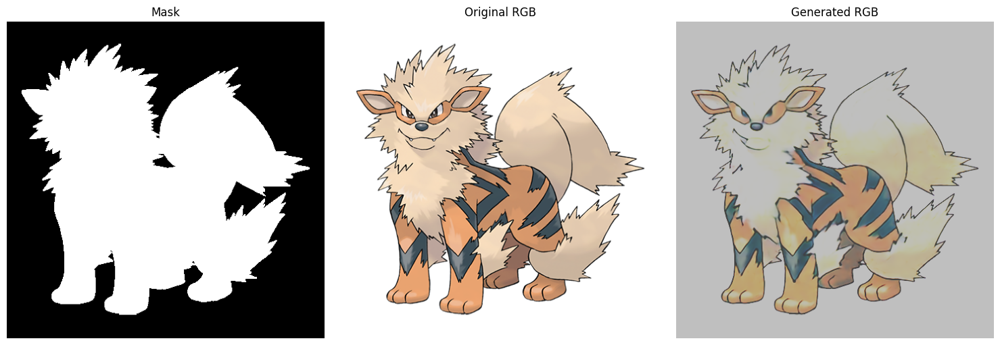

Generated RGB image saved at: output_images/batch_5_sample_1_generated.png
SSIM: 0.9182


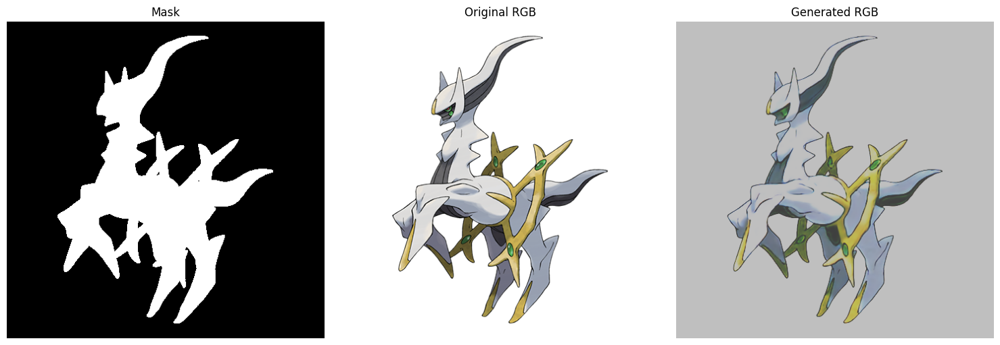

Generated RGB image saved at: output_images/batch_5_sample_2_generated.png
SSIM: 0.9199


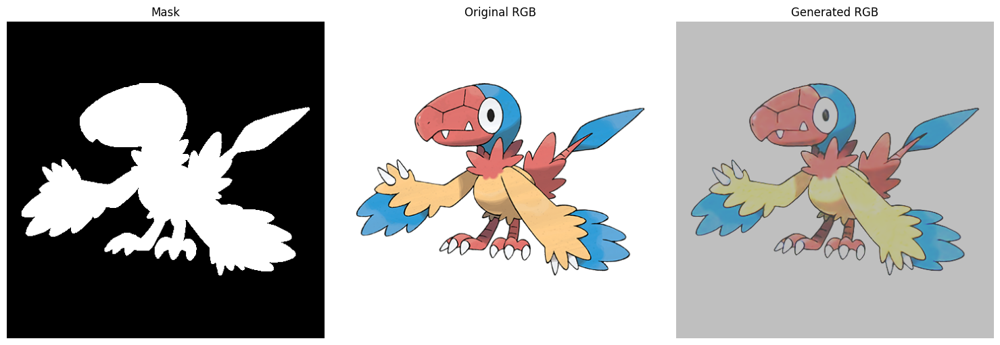

Generated RGB image saved at: output_images/batch_5_sample_3_generated.png
SSIM: 0.8954


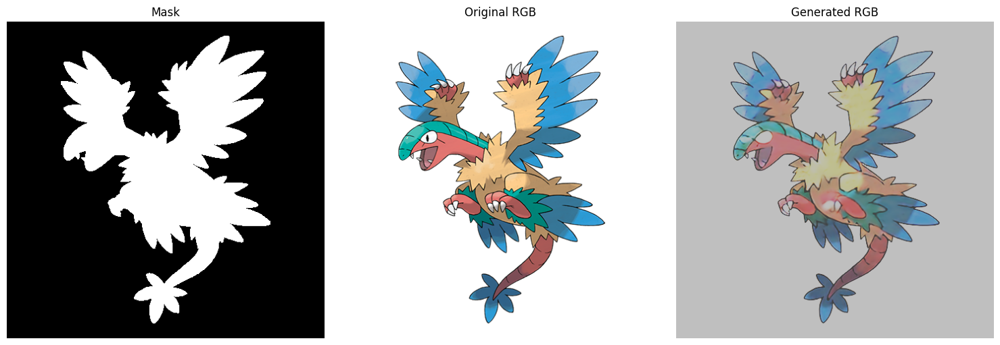

Generated RGB image saved at: output_images/batch_6_sample_0_generated.png
SSIM: 0.9019


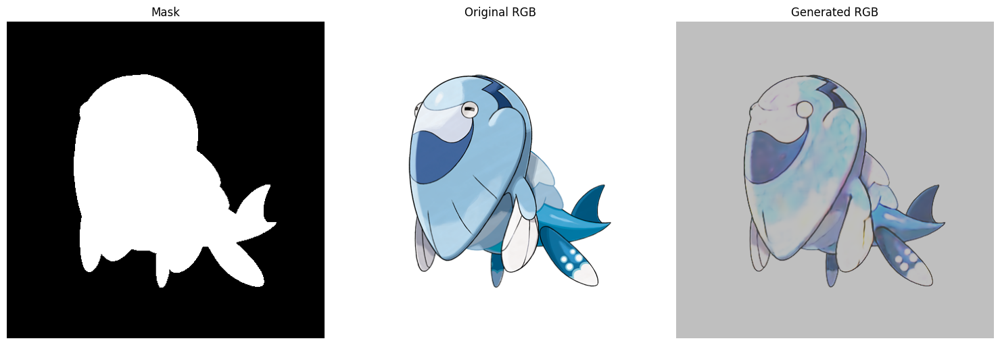

Generated RGB image saved at: output_images/batch_6_sample_1_generated.png
SSIM: 0.9020


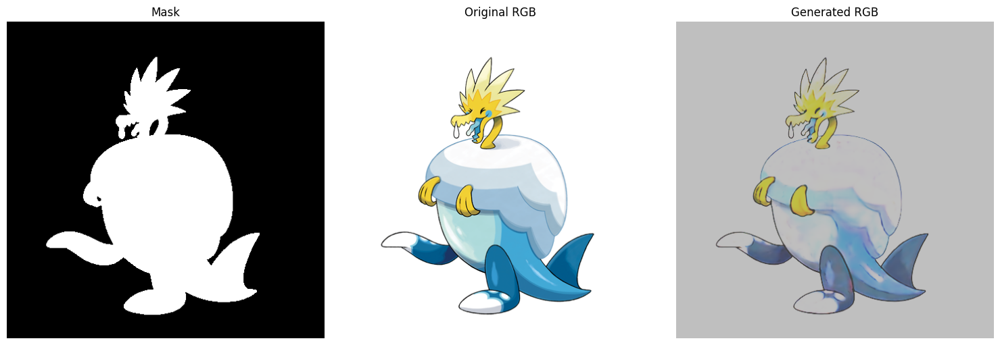

Generated RGB image saved at: output_images/batch_6_sample_2_generated.png
SSIM: 0.8758


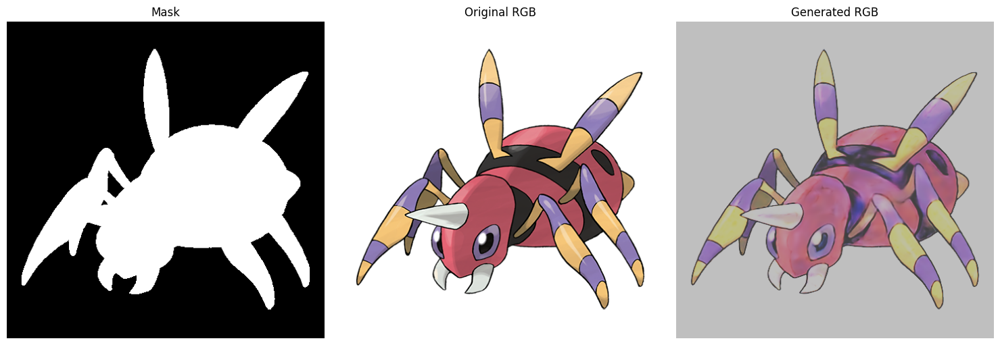

Generated RGB image saved at: output_images/batch_6_sample_3_generated.png
SSIM: 0.8795


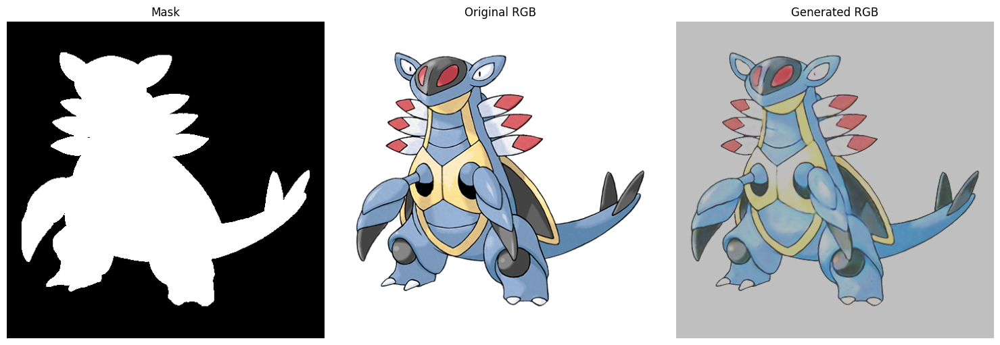

Generated RGB image saved at: output_images/batch_7_sample_0_generated.png
SSIM: 0.9022


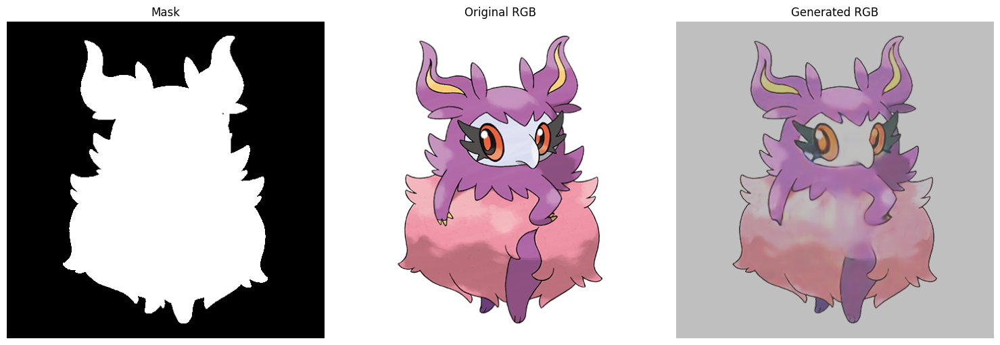

Generated RGB image saved at: output_images/batch_7_sample_1_generated.png
SSIM: 0.8513


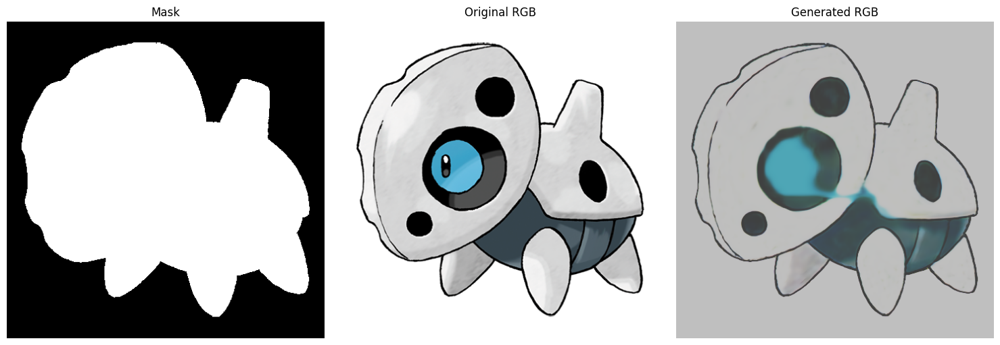

Generated RGB image saved at: output_images/batch_7_sample_2_generated.png
SSIM: 0.9286


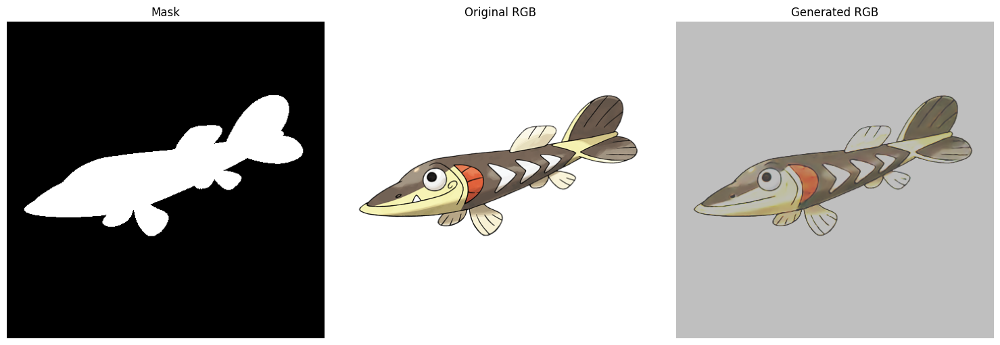

Generated RGB image saved at: output_images/batch_7_sample_3_generated.png
SSIM: 0.8993


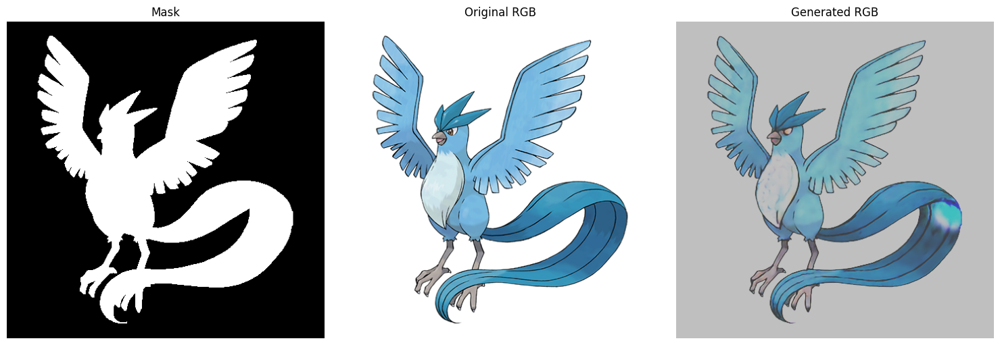

Generated RGB image saved at: output_images/batch_8_sample_0_generated.png
SSIM: 0.9141


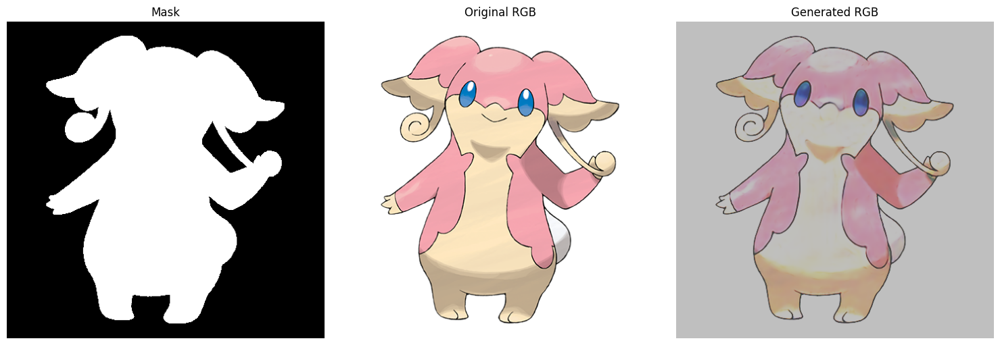

Generated RGB image saved at: output_images/batch_8_sample_1_generated.png
SSIM: 0.9222


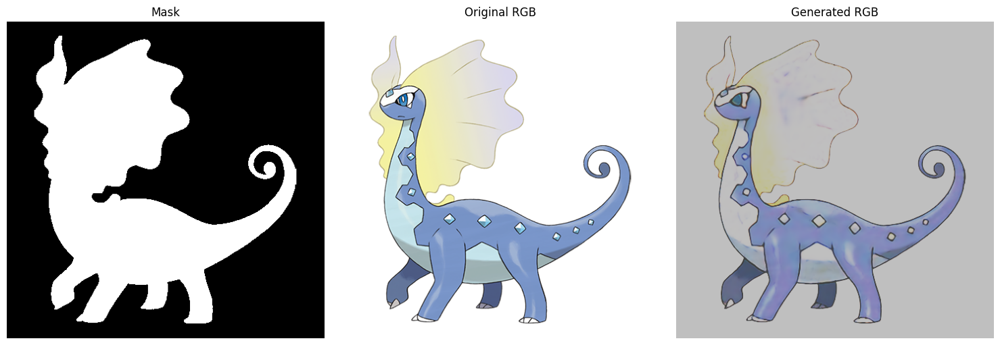

Generated RGB image saved at: output_images/batch_8_sample_2_generated.png
SSIM: 0.8841


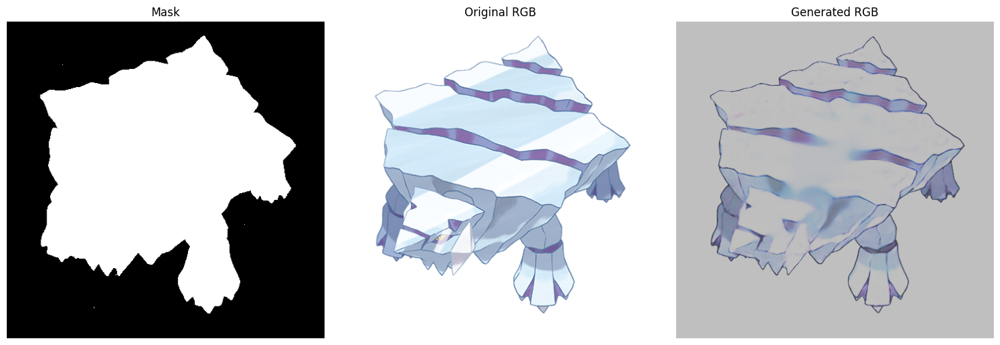

Generated RGB image saved at: output_images/batch_8_sample_3_generated.png
SSIM: 0.8943


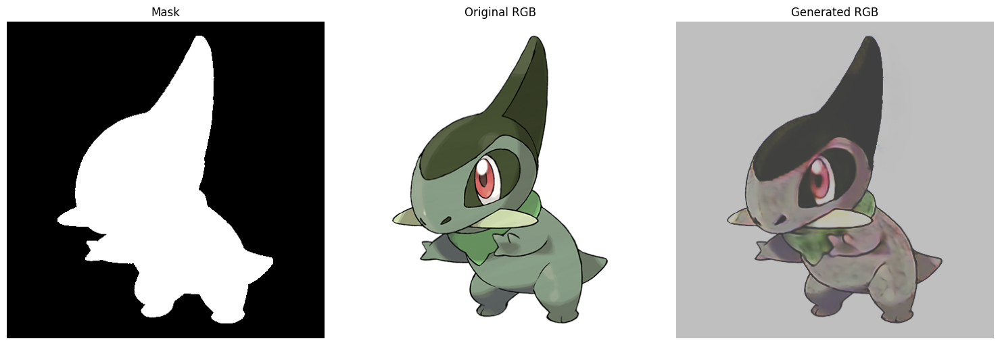

Generated RGB image saved at: output_images/batch_9_sample_0_generated.png
SSIM: 0.9188


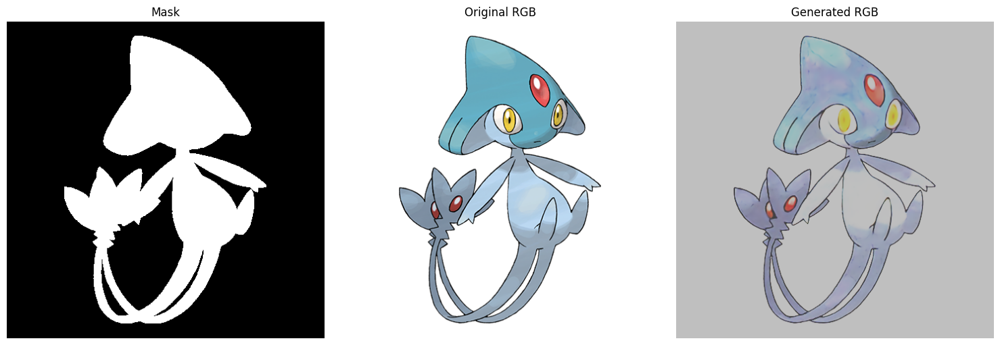

Generated RGB image saved at: output_images/batch_9_sample_1_generated.png
SSIM: 0.8883


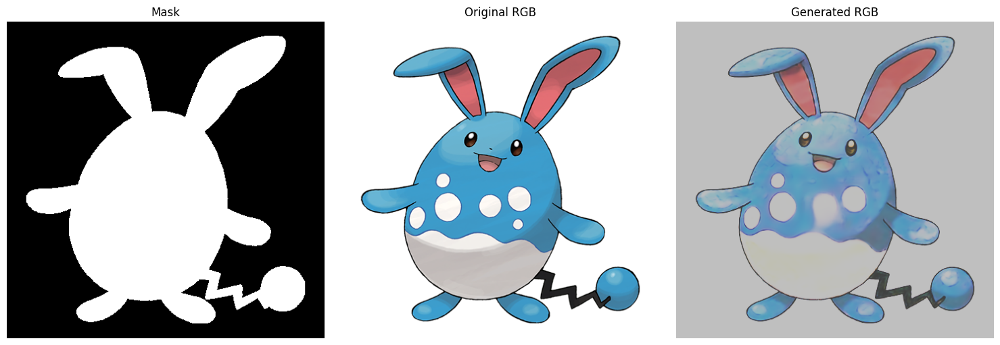

Generated RGB image saved at: output_images/batch_9_sample_2_generated.png
SSIM: 0.8907


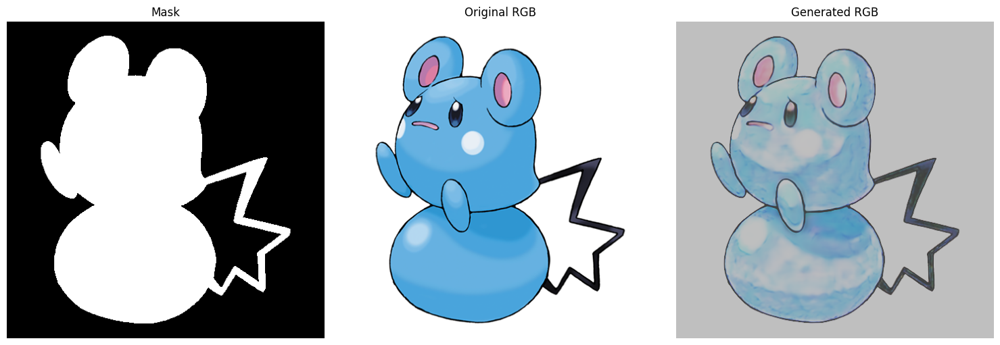

Generated RGB image saved at: output_images/batch_9_sample_3_generated.png


In [ ]:
# Load the .mat file
import os
from skimage.metrics import structural_similarity as ssim

# generator = UNetGenerator(input_channels=3, output_channels=3)

generator = torch.load("generator_full.pth")
generator.to(device)
generator.eval()

# Plotting function
def plot_sample(mask, rgb, generated_rgb):
    """
    Plots the original mask, RGB image, and generated RGB image.

    Args:
        mask (torch.Tensor): Grayscale mask of shape (1, H, W).
        rgb (torch.Tensor): Original RGB image of shape (3, H, W).
        generated_rgb (torch.Tensor): Generated RGB image of shape (3, H, W).
    """
    # Prepare the images for plotting
    mask_np = mask[0].cpu().numpy()*255  # Extract mask channel  
    
    # Denormalize and prepare the images
    mean = torch.tensor([0.5, 0.5, 0.5], device=rgb.device).view(1, 3, 1, 1)
    std = torch.tensor([0.25, 0.25, 0.25], device=rgb.device).view(1, 3, 1, 1)

    rgb_np = rgb*std + mean
    rgb_np = rgb_np.squeeze(0).detach().cpu().numpy()
    rgb_np = (rgb_np* 255).clip(0, 255).astype("uint8")
    rgb_np = np.transpose(rgb_np, (1,2,0))

    generated_rgb_np  = generated_rgb*std + mean
    generated_rgb_np = generated_rgb_np.squeeze(0).detach().cpu().numpy()
    generated_rgb_np = (generated_rgb_np* 255).clip(0, 255).astype("uint8")
    generated_rgb_np = np.transpose(generated_rgb_np, (1,2,0))

    # Calculate SSIM for each channel and average the scores
    ssim_scores = [
        ssim(rgb_np[:, :, c], generated_rgb_np[:, :, c], data_range=255)
        for c in range(rgb_np.shape[2])
    ]
    avg_ssim = np.mean(ssim_scores)

    print(f"SSIM: {avg_ssim:.4f}")

    # Convert NumPy array to PIL image
    # Plot the images
    plt.figure(figsize=(15, 5))

    # Mask
    plt.subplot(1, 3, 1)
    plt.imshow(mask_np, cmap='gray')
    plt.title("Mask")
    plt.axis("off")

    # Original RGB
    plt.subplot(1, 3, 2)
    plt.imshow(rgb_np)
    plt.title("Original RGB")
    plt.axis("off")

    # Generated RGB
    plt.subplot(1, 3, 3)
    plt.imshow(generated_rgb_np)
    plt.title("Generated RGB")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

def save_generated_rgb(generated_rgb, batch_idx, sample_idx, output_dir="output_images"):
    """
    Saves the generated RGB image to a file.

    Args:
        generated_rgb (torch.Tensor): Generated RGB image of shape (3, H, W).
        batch_idx (int): Batch index.
        sample_idx (int): Sample index within the batch.
        output_dir (str): Directory to save the image files.
    """
    # Denormalize and prepare the images
    mean = torch.tensor([0.5, 0.5, 0.5], device=generated_rgb.device).view(1, 3, 1, 1)
    std = torch.tensor([0.25, 0.25, 0.25], device=generated_rgb.device).view(1, 3, 1, 1)

    generated_rgb_np  = generated_rgb*std + mean
    generated_rgb_np = generated_rgb_np.squeeze(0).detach().cpu().numpy()
    generated_rgb_np = (generated_rgb_np* 255).clip(0, 255).astype("uint8")
    generated_rgb_np = np.transpose(generated_rgb_np, (1,2,0))

    # Create the output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    # Convert the NumPy array to a PIL Image
    image = Image.fromarray(generated_rgb_np)
    output_path = os.path.join(output_dir, f"batch_{batch_idx}_sample_{sample_idx}_generated.png")
    image.save(output_path)
    # Save the image as a PNG file
    print(f"Generated RGB image saved at: {output_path}")
    
# Process 10 batches, each with 4 samples
batch_size = 4
num_batches = 10
output_directory = "output_images"  # Directory to save the images

# Iterate through train_loader to process 10 batches
for batch_idx, (masks_batch, rgbs_batch) in enumerate(dataloader):
    if batch_idx >= 11:  # Stop after processing 10 batches
        break

    # Move the batch data to the device
    masks_batch = masks_batch.to(device)  # Shape: (batch_size, C, H, W)
    rgbs_batch = rgbs_batch.to(device)   # Shape: (batch_size, C, H, W)

    # Process each sample in the batch
    for sample_idx in range(masks_batch.size(0)):  # Loop over the batch size
        with torch.no_grad():
            # Remove batch dimension
            test_mask = masks_batch[sample_idx].unsqueeze(0)  # Add batch dimension
            test_rgb = rgbs_batch[sample_idx].unsqueeze(0)    # Add batch dimension
            generated_rgb = generator(test_mask).squeeze(0)   # Remove batch dimension
        
        plot_sample(test_mask.squeeze(0), test_rgb.squeeze(0), generated_rgb)
        
        # Save only the generated RGB image
        save_generated_rgb(
            generated_rgb, 
            batch_idx, 
            sample_idx, 
            output_dir=output_directory
        )